<a href="https://colab.research.google.com/github/Umesh1307/Email-Campaign-Effectiveness-Prediction-Supervised-Multiclass-Classfication-/blob/main/(Team_Notebook)_Email_Campaign_Effectiveness_Prediction_(Supervised_Classification_Capstone_Project).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Email Campaign Effectiveness Prediction**
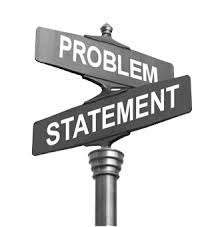

---



# **Problem Statement:**

---


## Most of the small to medium business owners are making effective use of Gmail-based Email marketing Strategies for offline targeting of converting their prospective customers into leads so that they stay with them in Business. The main objective is to create a machine learning model to characterize the mail and track the mail that is ignored; read; acknowledged by the reader.

---



## 😇 Before Delving deep straight into the coding part, let's understand the problem statement together 😇

---

### Electronic mail (or E-mail or email) is an Internet service that allows people who have an e-mail address (accounts) to send and receive electronic letters. Those are much like postal letters, except that they are delivered much faster than snail mail when sending over long distances, and are usually free.
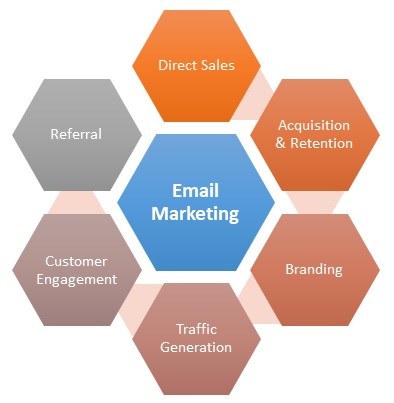

## Why This is Problem?
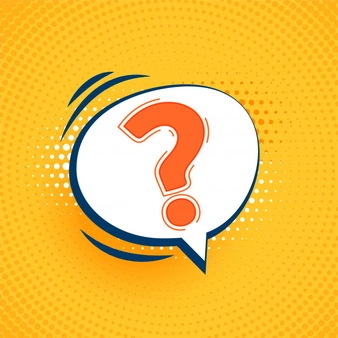
### Actually this problem is based on Email Marketing which is the act of sending a commercial message, typically to a group of people, using email. In its broadest sense, every email sent to a potential or current customer could be considered email marketing. It involves using email to send advertisements, request business, or solicit sales or donations.

Curious about email marketing [click the link](https://simple.wikipedia.org/wiki/E-mail)
---


---
# Definitions of Attributes
--- 
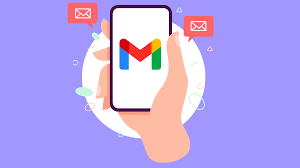
### The data has the following features:
### 1. Email_ID - This column contains the email ids of individuals.

### 2. Email_type - Email type contains 2 categories 1 and 2. We can assume that the types are like promotional email or sales email.

### 3. Subject_Hotness_Score - It is the subject-line effectiveness score.

### 4. Email_Source - It represents the source of the email like sales,marketing or product type email.

### 5. Email_Campaign_Type - Campaign type

### 6. Total_Past_Communications - This column contains the previous mails from the source.

### 7. Customer_Location - Categorical data which explains the different demographic location of the customers.

### 8. Time_Email_sent_Category - It has 3 categories: 1,2 and 3 which are considered as morning,evening and night time slot.

### 9. Word_Count - It contains the no.of words in the mail.

### 10. Total_Links - Total links in the email body.

### 11. Total_Images - The banner images in the email body.

### 12. Email_Status - It is the target variable which contains the characterization of the mail that is ignored; read; acknowledged by the reader.
--- 


# Objective of Project:
--- 
* ###  The main objective is to create a machine learning model to characterize the mail and track the mail that is ignored; read; acknowledged by the reader.

* ###  In addition to the ML Model prediction, we also analyzed what all features can help us in getting the Email status to be not ignored by the customers.
--- 

# Process Outline:
--- 
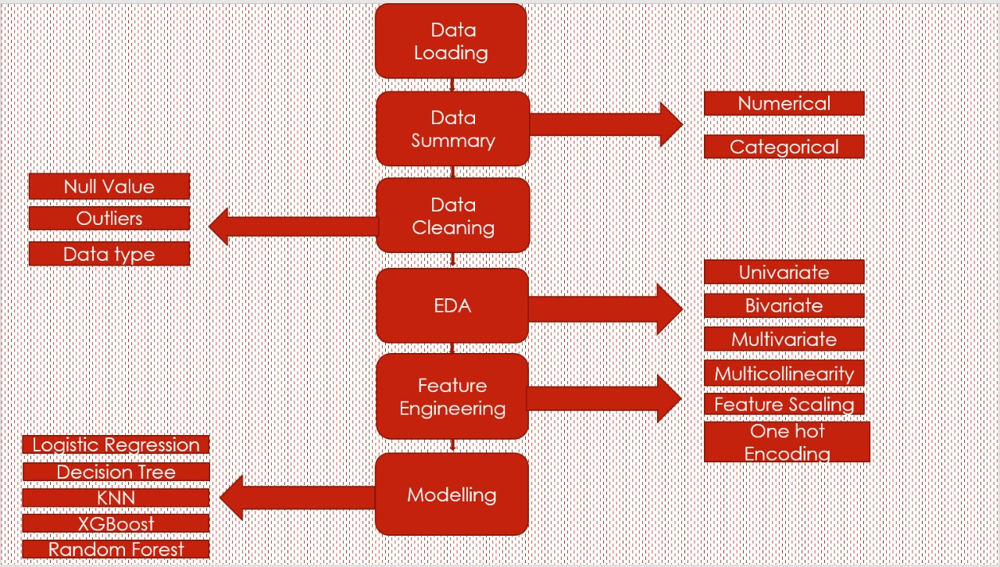

# *STEP 1: LOADING THE DATASET*

In [ ]:
#Importing Modules
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from scipy import stats
import pylab
import missingno as mno
from sklearn import metrics
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, roc_auc_score, f1_score, recall_score,roc_curve,classification_report
from sklearn.model_selection import train_test_split
#importing random under sampler
from imblearn.under_sampling import RandomUnderSampler
from collections import Counter
#importing SMOTETomek
from imblearn.combine import SMOTETomek 
#importing TomekLinks
from imblearn.under_sampling import TomekLinks


from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV

from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from xgboost import XGBClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier

# This is to supress the warning messages (if any) generated in our code
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# Mounting drive with google colab notebook
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Loading the dataset
email_df=pd.read_csv("/content/drive/MyDrive/Almabetter Project/Capstone - Projects/Module 4 Supervised ML Classification/data_email_campaign.csv")

In [ ]:
# Let's have a look at the head of dataset
email_df.head()

,Email_ID,Email_Type,Subject_Hotness_Score,Email_Source_Type,Customer_Location,Email_Campaign_Type,Total_Past_Communications,Time_Email_sent_Category,Word_Count,Total_Links,Total_Images,Email_Status
0,EMA00081000034500,1,2.2,2,E,2,33.0,1,440,8.0,0.0,0
1,EMA00081000045360,2,2.1,1,NaN,2,15.0,2,504,5.0,0.0,0
2,EMA00081000066290,2,0.1,1,B,3,36.0,2,962,5.0,0.0,1
3,EMA00081000076560,1,3.0,2,E,2,25.0,2,610,16.0,0.0,0
4,EMA00081000109720,1,0.0,2,C,3,18.0,2,947,4.0,0.0,0


In [ ]:
# Let's use the colab data table feature to visualize explictly! This feature was new one for me :)
from google.colab.data_table import DataTable
DataTable(email_df)

,Email_ID,Email_Type,Subject_Hotness_Score,Email_Source_Type,Customer_Location,Email_Campaign_Type,Total_Past_Communications,Time_Email_sent_Category,Word_Count,Total_Links,Total_Images,Email_Status
0,EMA00081000034500,1,2.2,2,E,2,33.0,1,440,8.0,0.0,0
1,EMA00081000045360,2,2.1,1,NaN,2,15.0,2,504,5.0,0.0,0
2,EMA00081000066290,2,0.1,1,B,3,36.0,2,962,5.0,0.0,1
3,EMA00081000076560,1,3.0,2,E,2,25.0,2,610,16.0,0.0,0
4,EMA00081000109720,1,0.0,2,C,3,18.0,2,947,4.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
68348,EMA00089995974500,2,0.4,1,F,2,22.0,3,737,16.0,13.0,0
68349,EMA00089998225300,1,1.3,1,C,2,40.0,2,653,31.0,16.0,0
68350,EMA00089998436500,1,2.2,2,NaN,2,33.0,2,490,9.0,0.0,0
68351,EMA00089999168800,1,0.4,1,E,2,50.0,1,733,14.0,4.0,0


# A few interesting features of the data table display:😇

---


* ### Clicking the Filter button in the upper right allows you to search for terms or values in any particular column.

* ### Clicking on any column title lets you sort the results according to that column's value.

* ### The table displays only a subset of the data at a time. You can navigate through pages of data using the controls on the lower right.

---




In [ ]:
# Checking the tail of the dataset:)
email_df.tail(3)

,Email_ID,Email_Type,Subject_Hotness_Score,Email_Source_Type,Customer_Location,Email_Campaign_Type,Total_Past_Communications,Time_Email_sent_Category,Word_Count,Total_Links,Total_Images,Email_Status
68350,EMA00089998436500,1,2.2,2,NaN,2,33.0,2,490,9.0,0.0,0
68351,EMA00089999168800,1,0.4,1,E,2,50.0,1,733,14.0,4.0,0
68352,EMA00089999316900,1,1.5,1,G,2,20.0,2,1038,6.0,0.0,0


In [ ]:
# Checking the shape of the dataset:)
print(f"The Shape of dataset is {email_df.shape} There are {email_df.shape[0]} rows and {email_df.shape[1]} columns")

The Shape of dataset is (68353, 12) There are 68353 rows and 12 columns


# Information understanding:

---


### We will be using pandas info method and checking the information about the features, about their datatypes (float, integer, object, datetime, null(missing) or non-null(non-missing), total number of entities in each features.

---




In [ ]:
# Let's have a look at the data type of the features.
email_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 68353 entries, 0 to 68352
Data columns (total 12 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Email_ID                   68353 non-null  object 
 1   Email_Type                 68353 non-null  int64  
 2   Subject_Hotness_Score      68353 non-null  float64
 3   Email_Source_Type          68353 non-null  int64  
 4   Customer_Location          56758 non-null  object 
 5   Email_Campaign_Type        68353 non-null  int64  
 6   Total_Past_Communications  61528 non-null  float64
 7   Time_Email_sent_Category   68353 non-null  int64  
 8   Word_Count                 68353 non-null  int64  
 9   Total_Links                66152 non-null  float64
 10  Total_Images               66676 non-null  float64
 11  Email_Status               68353 non-null  int64  
dtypes: float64(4), int64(6), object(2)
memory usage: 6.3+ MB




---


# Observations:

---

* ### There are in total 11 variables out of which 10 are independent variables and 1 is dependent which is our target variable.

* ### Categorical Data:
### Out of all the features we have a total of 6 categorical feature variables.
1. * Email_Type
2. * Email_source_Type
3. * Customer_location
4. * Email_Campaign_type
5. * Time_Email_Sent_Catagory
6. * Email_Satus

* ### Target Variable: Email_Status Out of these categorical variables, Email_Status is our target variable which shows 3 different statuses as “Ignored”, “Read” and “Acknowledged”.

* ### There are five numerical or continuous features namely 
1. * "Subject_Hotness_Score" 
2. * "Total_Past_Communications", 
3. * "Word_Count", 
4. * "Total_Links", 
5. * "Total_Images".

* ### There are null values in Customer_Location, Total_Past_Communications, Total_Links, Total_Images features.



---




# *Cleaning, Transforming, Null Value Treatment:*

---


* ## cleaning:

### In this process or step we will be removing undesired features, unwanted prefixes, suffixes we will be having in our data.

* ## Transforming:

### In this step we will transform the datatype of given features to the desired datatype.

* ## Null Value Treatment:
### Here we will be using pandas isnull method to check the presence of null values and if they exist we will be filling them out with appropriate logical reasons and calculation.

---



In [ ]:
# checking if there is any null value in dataset
email_df.isnull().any()

Email_ID                     False
Email_Type                   False
Subject_Hotness_Score        False
Email_Source_Type            False
Customer_Location             True
Email_Campaign_Type          False
Total_Past_Communications     True
Time_Email_sent_Category     False
Word_Count                   False
Total_Links                   True
Total_Images                  True
Email_Status                 False
dtype: bool

In [ ]:
# Calculating the total number of null values inside each features
email_df.isnull().sum()

Email_ID                         0
Email_Type                       0
Subject_Hotness_Score            0
Email_Source_Type                0
Customer_Location            11595
Email_Campaign_Type              0
Total_Past_Communications     6825
Time_Email_sent_Category         0
Word_Count                       0
Total_Links                   2201
Total_Images                  1677
Email_Status                     0
dtype: int64

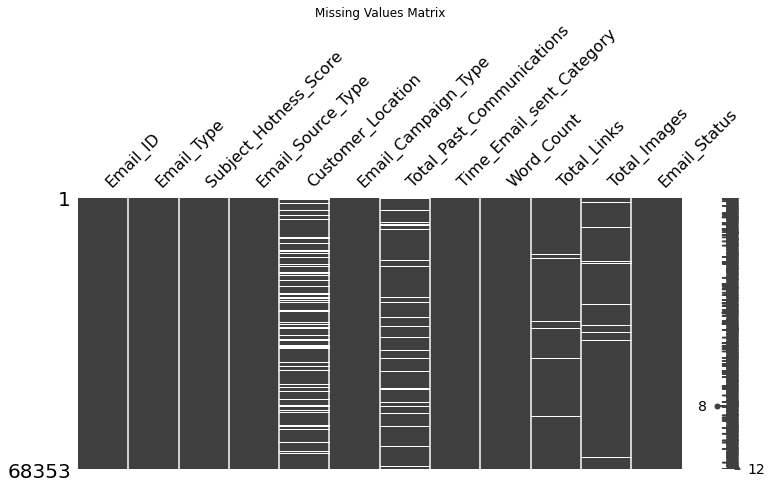

In [ ]:
# Let's have a look at the missing values matrix
ax=mno.matrix(email_df, figsize = (12, 5))
plt.title("Missing Values Matrix")
plt.show()

In [ ]:
## Lets go and see the percentage of missing values
email_df.isnull().mean()

Email_ID                     0.000000
Email_Type                   0.000000
Subject_Hotness_Score        0.000000
Email_Source_Type            0.000000
Customer_Location            0.169634
Email_Campaign_Type          0.000000
Total_Past_Communications    0.099849
Time_Email_sent_Category     0.000000
Word_Count                   0.000000
Total_Links                  0.032200
Total_Images                 0.024534
Email_Status                 0.000000
dtype: float64

In [ ]:
# Check for duplicates
duplicate_df = email_df[email_df.duplicated()]
duplicate_df

,Email_ID,Email_Type,Subject_Hotness_Score,Email_Source_Type,Customer_Location,Email_Campaign_Type,Total_Past_Communications,Time_Email_sent_Category,Word_Count,Total_Links,Total_Images,Email_Status




---


# Observations:

---
* ### There are null values in four features namely, customer_location, total_past_communication, Total_links, Total_images.
* ### There are no duplicate values found!

---




# *EXPLORATORY DATA ANALYSIS :*
### In statistics, exploratory data analysis is an approach of analyzing data sets to summarize their main characteristics, often using statistical graphics and other data visualization methods.
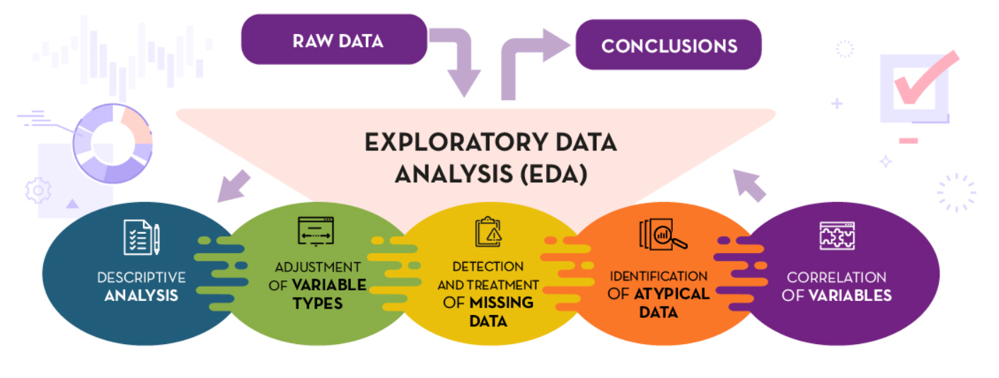


[Read here more about exploratory data analysis](https://en.wikipedia.org/wiki/Exploratory_data_analysis)
---





---


# *DESCRIPTIVE STATISTICAL ANALYSIS*

---
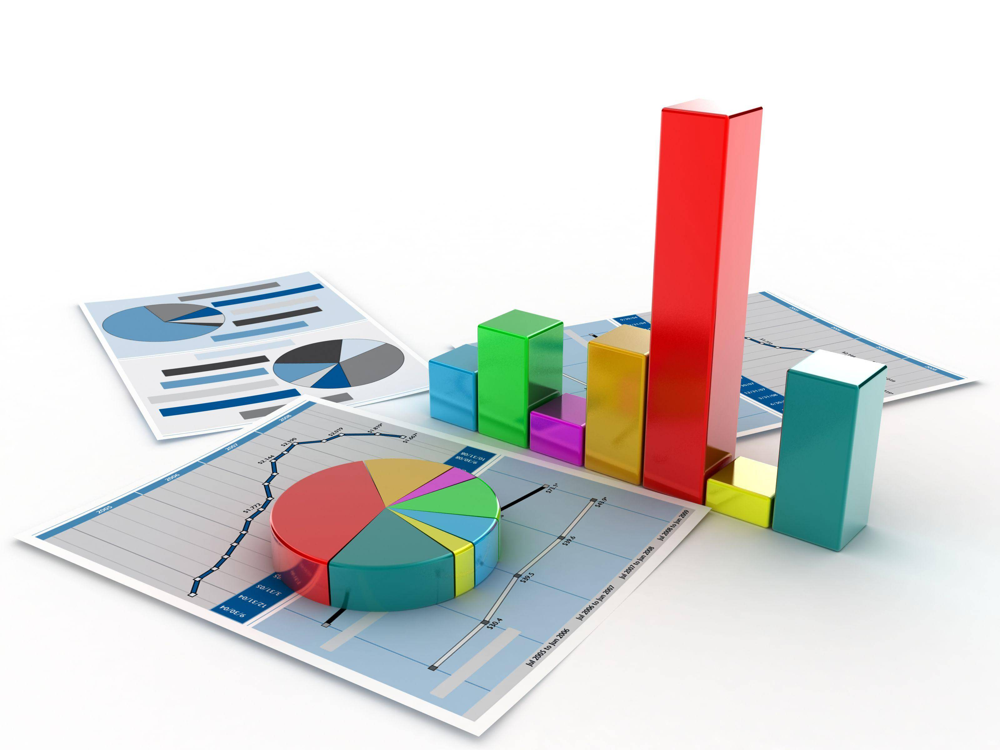

### Here we will be using pandas describe method to have an intution about the basic behaviour of data, furthermore we will use pandas profilling to have a more understanding of the data.




---



In [ ]:
# Let's see the descriptive statistics for numerical features
from google.colab import data_table                           # Importing the datatable extension of google colab.
email_df_describe=email_df[['Subject_Hotness_Score','Total_Past_Communications','Word_Count','Total_Links','Total_Images']].describe().round(2) # Selcting numerical columns only
email_df_describe

,Subject_Hotness_Score,Total_Past_Communications,Word_Count,Total_Links,Total_Images
count,68353.0,61528.00,68353.00,66152.00,66676.00
mean,1.1,28.93,699.93,10.43,3.55
std,1.0,12.54,271.72,6.38,5.60
min,0.0,0.00,40.00,1.00,0.00
25%,0.2,20.00,521.00,6.00,0.00
50%,0.8,28.00,694.00,9.00,0.00
75%,1.8,38.00,880.00,14.00,5.00
max,5.0,67.00,1316.00,49.00,45.00




---


# Observations:

---

* ### Subject Hotness Score is float value ranges from 0 to 5, where 0 is not hot, 5 is very hot. The average subject hotness score for the given data set is around 1.10



* ### Average total past communications is around 29. maximum total past communications are around 67 and the minimum is 0.



* ### Average word count is around 700 words. An email was sent with maximum words of around 1316 words. An email was sent with minimum words around 40 words.



* ### Average total links sent is around 11 links, and the maximum total links sent is around 49 links, the minimum is 1 link.



* ### Average total images sent through an email is around 4 images. The maximum total images sent are around 45 images.

---






---


# *Null Value Imputation*:

### Here we will be understanding the data distribution at first, then, we will deciding which matrics to be used for missing value imputataion.

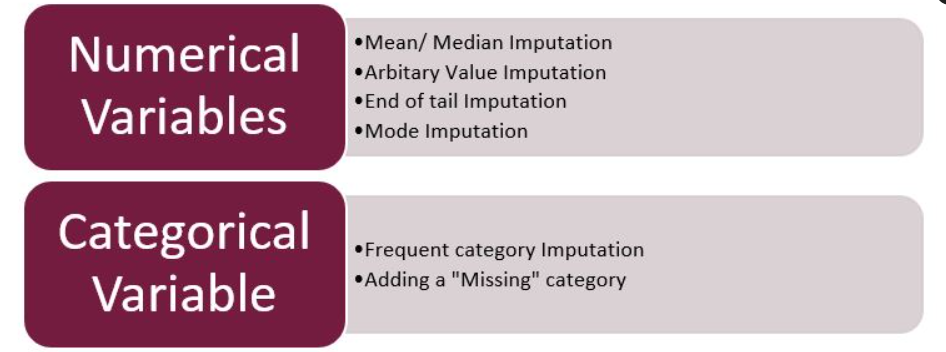
---




In [ ]:
# selecting numeric features from data set
numeric_features = email_df[['Subject_Hotness_Score','Total_Past_Communications','Word_Count','Total_Links','Total_Images']].describe().columns

In [ ]:
numeric_features

Index(['Subject_Hotness_Score', 'Total_Past_Communications', 'Word_Count',
       'Total_Links', 'Total_Images'],
      dtype='object')

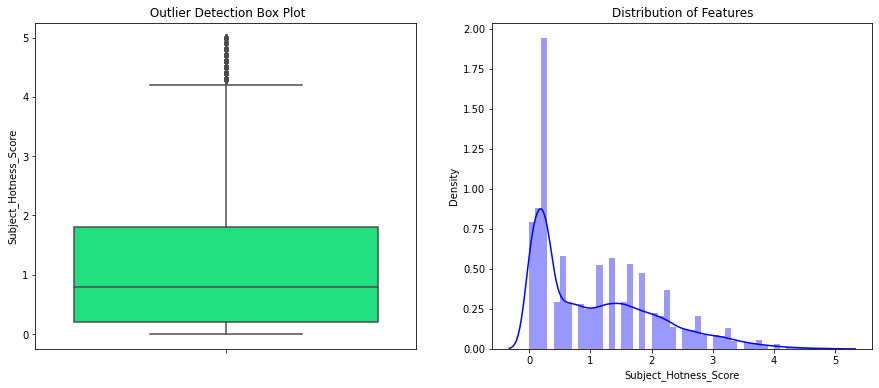

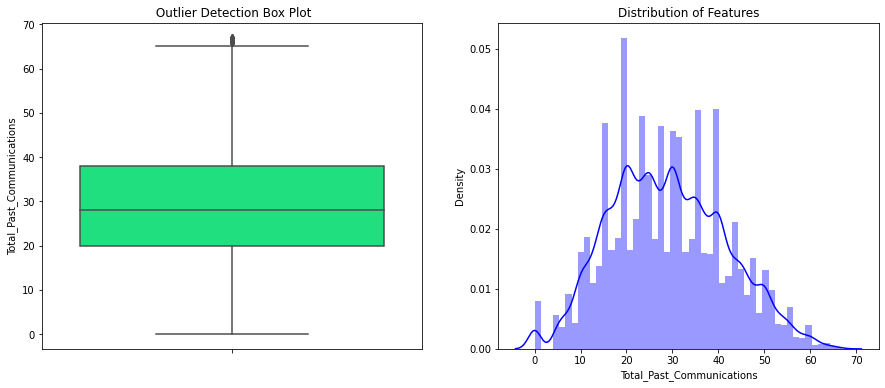

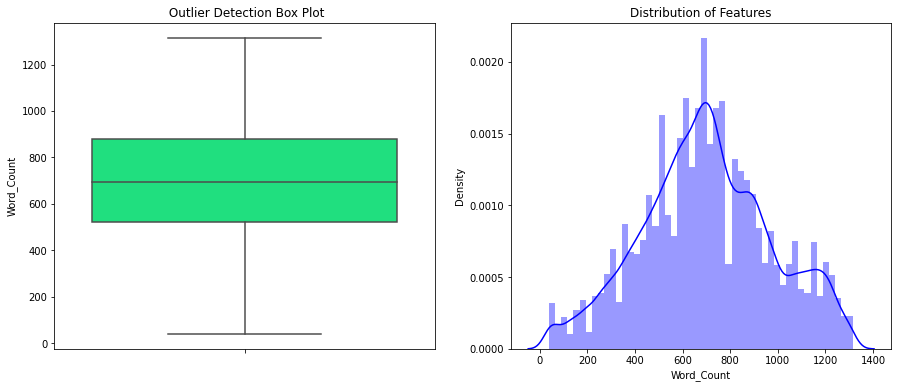

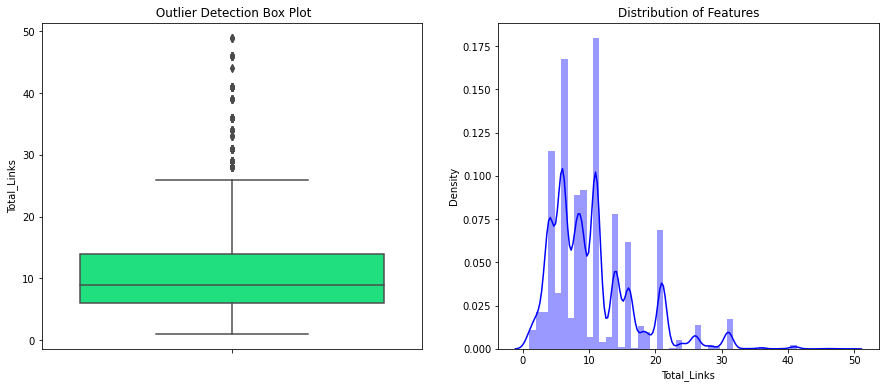

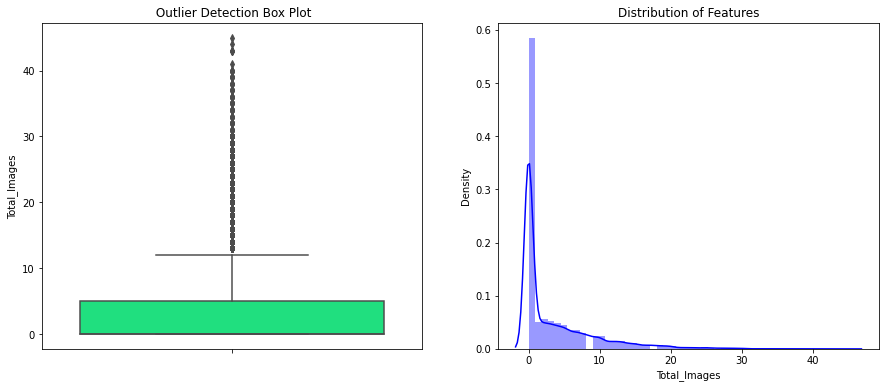

In [ ]:
# Plotting the distribution of the numerical features
for var in numeric_features:
    plt.figure(figsize=(15,6))
    plt.subplot(1, 2, 1)
    fig = sns.boxplot(y=email_df[var], color='#00FF7F')
    fig.set_title(' Outlier Detection Box Plot')
    fig.set_ylabel(var)
    
    plt.subplot(1, 2, 2)
    fig = sns.distplot(email_df[var].dropna(),color='blue')
    fig.set_title("Distribution of Features")
    fig.set_xlabel(var)
    plt.show()



---


# Observations:

---

* ### We observe that 2 features i.e. “ Word Count” and “Total_Past Communications” follow a normal distribution. 

* ### The rest of the features were highly skewed to the left.

* ### As we can observe the "Total_Past_Communications" is symmetricaly distributed so we can use mean value for imputing missing values for this feature.

* ### Since the "Total_Links" is not normally distributed we will use Mode to impute missing value for this feature.

* ### Since the "Total_Images" is not normally distributed and highly rightly skewed, we will use Mode to impute missing value for this feature.

* ### There are outliers in Subject_Hotness_Score,Total_Links and Total_Images and the distribution of these features are right skewed in nature. There are also a few outliers in Total_Past_Communication which has a normal distribution .
---



In [ ]:
# Imputting null values for total past communications feature with mean
print('Number of missing values before imputing is = ',email_df['Total_Past_Communications'].isnull().sum())
email_df['Total_Past_Communications'].fillna(email_df['Total_Past_Communications'].mean(),inplace=True)
print('Number of missing values after imputing is = ',email_df['Total_Past_Communications'].isnull().sum())

Number of missing values before imputing is =  6825
Number of missing values after imputing is =  0


In [ ]:
#Filling missing values of Total_Links column
print('Number of missing values before imputing is = ',email_df['Total_Links'].isnull().sum())
email_df['Total_Links'].fillna(email_df['Total_Links'].mode()[0],inplace=True)
print('Number of missing values after imputing is = ',email_df['Total_Links'].isnull().sum())

Number of missing values before imputing is =  2201
Number of missing values after imputing is =  0


In [ ]:
#Filling missing values of Total_Links column
print('Number of missing values before imputing is = ',email_df['Total_Images'].isnull().sum())
email_df['Total_Images'].fillna(email_df['Total_Images'].mode()[0],inplace=True)
print('Number of missing values after imputing is = ',email_df['Total_Images'].isnull().sum())

Number of missing values before imputing is =  1677
Number of missing values after imputing is =  0


In [ ]:
# Installing sweetviz
!pip install sweetviz


     |████████████████████████████████| 15.1 MB 6.1 MB/s 


In [ ]:
# importing sweet
import sweetviz as sv

In [ ]:
report=sv.analyze(email_df)

                                             |          | [  0%]   00:00 -> (? left)


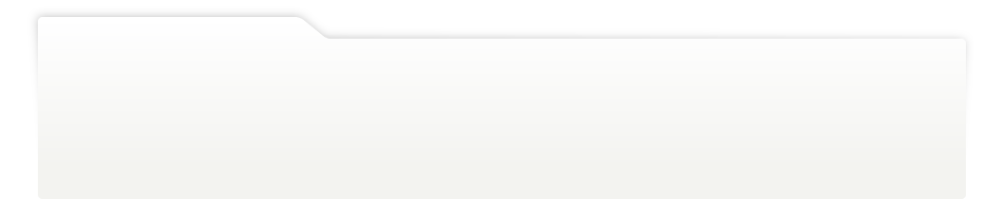
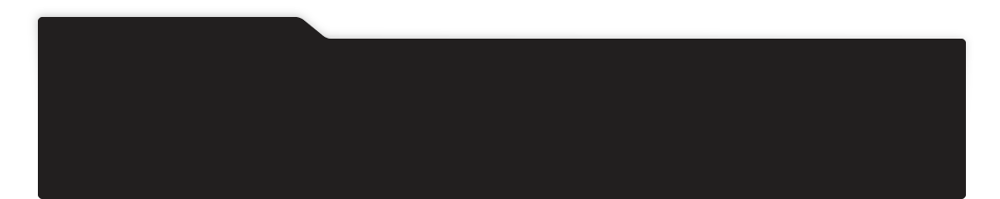
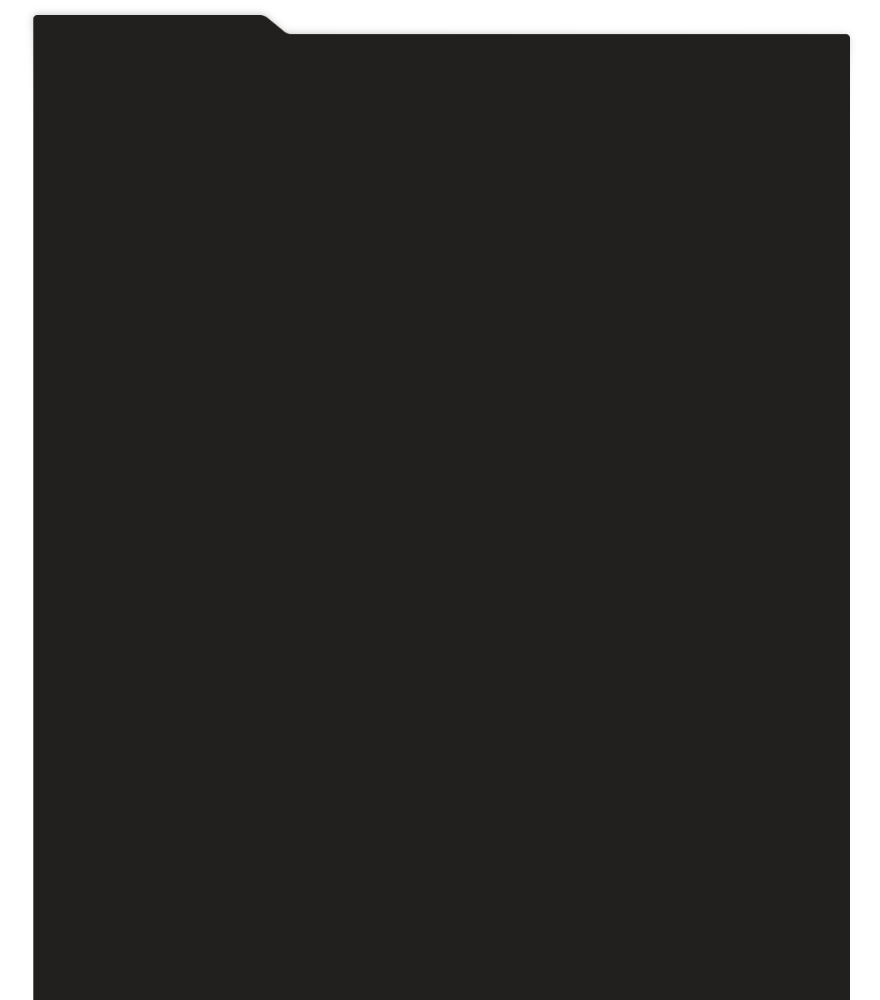
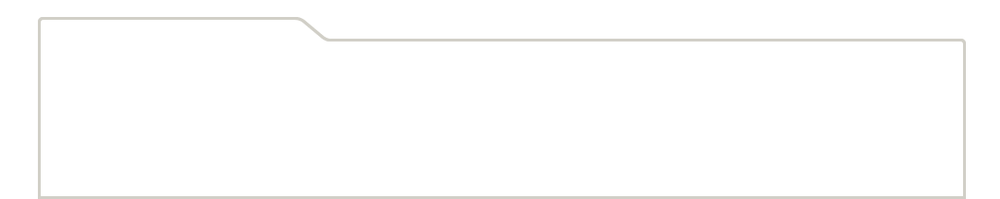
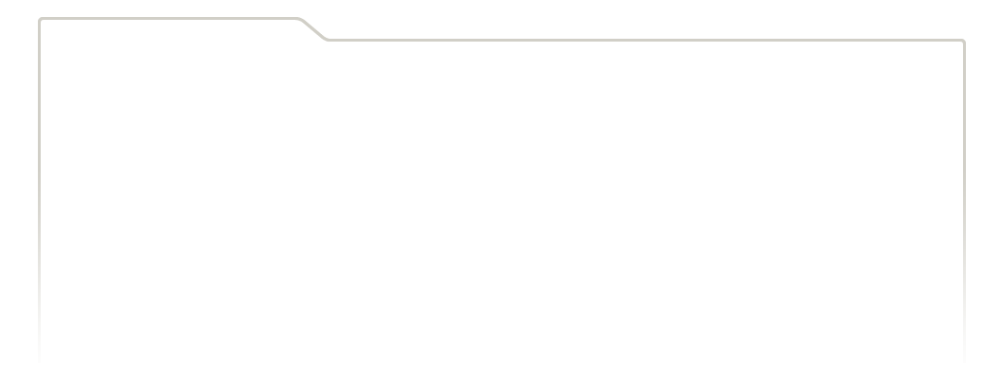
...
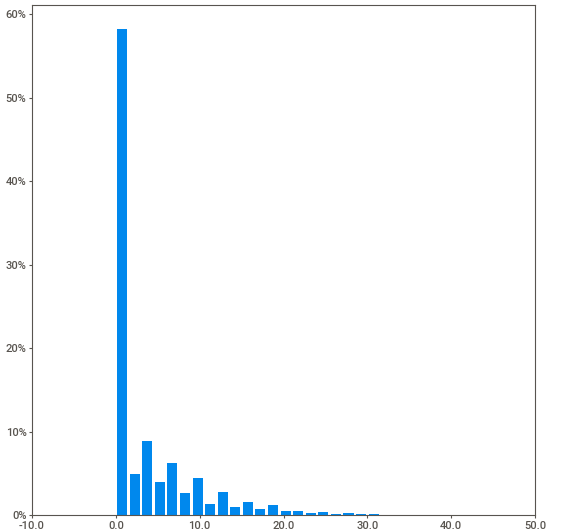
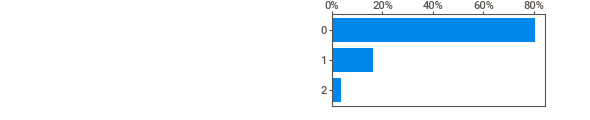
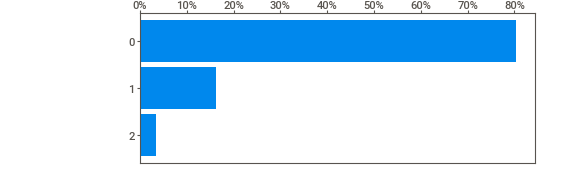
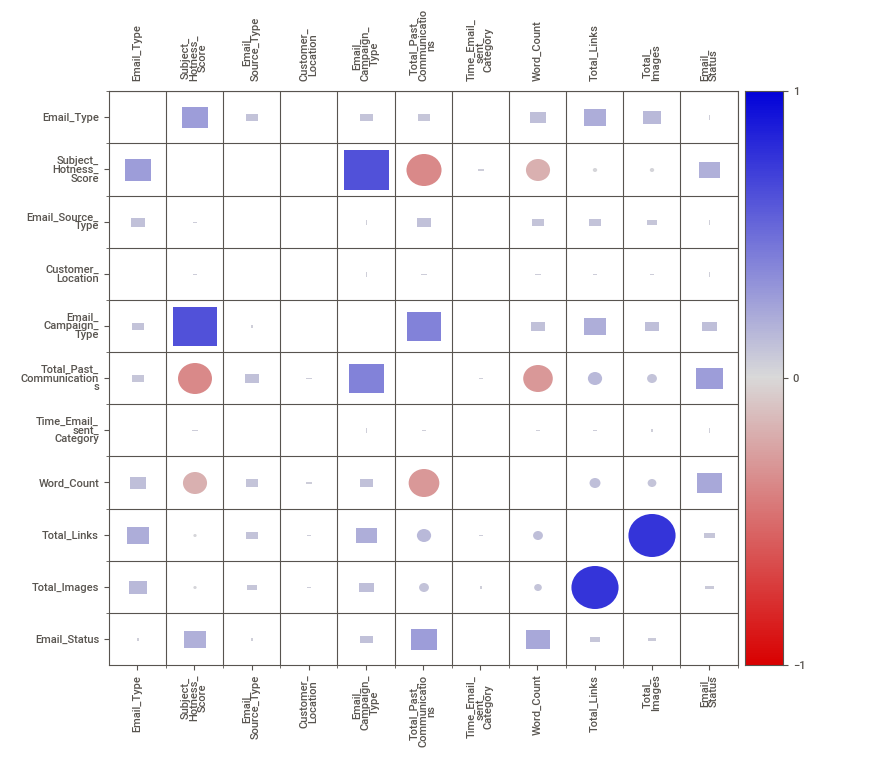
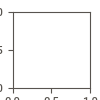

In [ ]:
# Collecting report
report.show_notebook()



---


# **Observations**:

---


### On reading the Fetures Statistics of the dataset we get the the following observations--
* ### All the Email_Id are unique ids.
* ### Email_Type has two categories 1(promotional email) and 2(sales email).More than 65% of the Email types are promotional emails.

* ### Subject Hotness Score varies in the range from 0 to 5. 95% of the subject hotness score is 3.The average subject hotness score is 1.10.

* ### There are two categories of the Email_Source_Types.Out of which more than 55% of them belongs to first one.

* ### About 17%(11595) values of Customer_Location are missing.There ae seven different types of locations in our dataset.

* ### There are three different categories for Email_Campaign_Type.Out of which more than 65% of them belongs to first one.

* ### About 10%(6825) values of Total_Past_Communications are missing.There are 64 distinct values out of which 657 are zeros.The average total past communication is 28.9,minimumm is 0 and maximum is 67.0.

* ### There are three categores for Time_Email_sent_Category that can be morning,afternoon and evening.Out of which 60% of them belongs to first one.

* ### The average Word_Count is 700, maximum is 1316 and minimum is 40.The average Total_links send in an email is 10.4,maximum is 49.0,and minimum is 40.About 3%(2201) of the total links are missing.

* ### The average Total_Images send in an email is 3.6, maximum is 45.0, and minimum is 0.About 2%(1677) total images are missing and 51%(35060) of them ae zeros.

* ### There are three categories of Email_Status that can be ignored,read and acknowledged.out of which about 80%(54941) of them are ignored,11%(11039) are read and 3%(2373) of them are acknowledged.

---





---


# Outlier Detection:

---


### Here we will be using Plotly boxplot for the numerical feature to find out the outlier. 

### Outliers are extreme values that deviate from other observations on data , they may indicate a variability in a measurement, experimental errors or a novelty. In other words, an outlier is an observation that diverges from an overall pattern on a sample. 

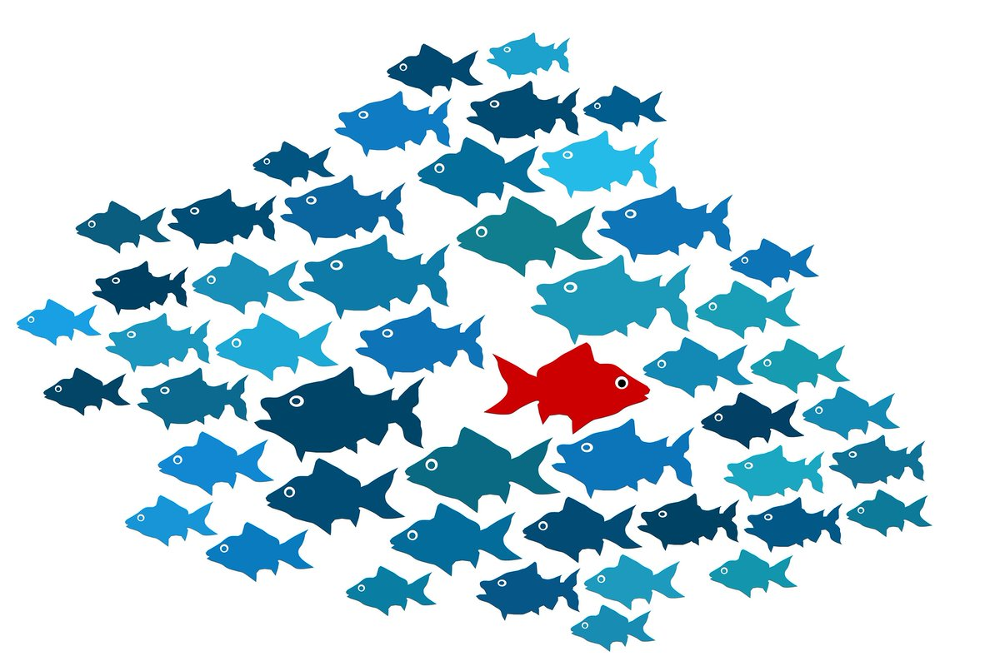

[read here about outlier detection](https://towardsdatascience.com/a-brief-overview-of-outlier-detection-techniques-1e0b2c19e561)

---



In [ ]:
# Calculating the outlier for numerical features
trace0 = go.Box(
    y=email_df['Subject_Hotness_Score'],
    x=email_df['Email_Status'],
    name='Email Status vs Subject Hotness Score',
    marker=dict(
        color='#3D9970'
    )
)
trace1 = go.Box(
    y=email_df['Total_Past_Communications'],
    x=email_df['Email_Status'],
    name='Email_Status Vs Total Past Communications',
    marker=dict(
        color='#FF4136'
    )
)
trace2=go.Box(
    y=email_df['Word_Count'], 
    x=email_df['Email_Status'],
    name='Email Status Vs Word Count'
)

trace3=go.Box(
    y=email_df['Total_Links'],
    x=email_df['Email_Status'],
    name='Email Status Vs Total Links'
)    

trace4=go.Box(
    y=email_df['Total_Images'],
    x=email_df['Email_Status'],
    name='Email Status Vs Total Images'
)

fig = make_subplots(rows=1, cols=5,  x_title='Email Status',
                    y_title='Values',
                    subplot_titles=("Subject Hotness Score",
                                                    "Total Past Communications","Word Count",
                                                    "Total Links","Total Images"))
fig.append_trace(trace0, 1, 1)
fig.append_trace(trace1, 1, 2)
fig.append_trace(trace2, 1, 3)
fig.append_trace(trace3, 1, 4)
fig.append_trace(trace4, 1, 5)
fig.update_layout(width=1500,height=500)

fig.show()




---


# Observations:

---


* ## ***Subject_Hotness_Score :*** 
### All Email_Status i.e 0,1,2 have outliers. 0 have highest median and 1,2 are right skewed. It is observed that the Subject_Hotness_Score for read/acknowledged mails are much lower.

* ## ***Total_Past_Communications :***
### 0,2 have outliers and 2 have highest median .

* ## ***Total_Links :***
### 0,1,2 all have outliers,All have the same median but 0,2 have higher variance compare to 1.

* ## ***Total_Images :***
### 0,1,2 all have outliers and All have the same median. Hence all the mails have the same range of images.

* ## ***Word_Count :*** 
### Median of 0 is highest. Thus we can understand that ignored mails have higher word count.


---



# *Categorical Data Analysis* :

---
## *Binary vs nominal vs ordinal variables*

### Binary variables (aka dichotomous variables) Yes/no outcomes :
    for instance: Heads/tails in a coin flip,Win/lose in a football game.

### Nominal variables: Groups with no rank or order between them.	
    For instance: Species names, Colors, Brands

### Ordinal variables: Groups that are ranked in a specific order.	
    For instance: Finishing place in a race
                  Rating scale responses in a survey

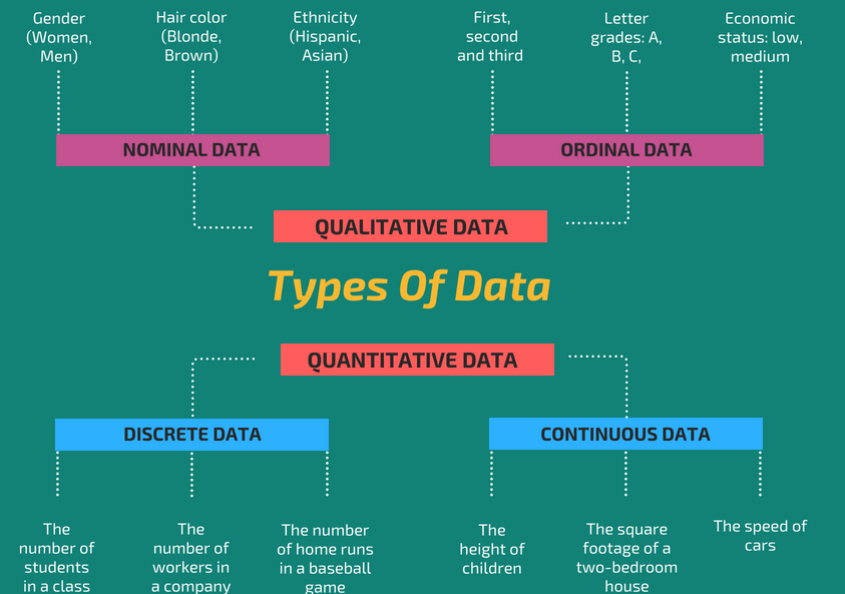

In [ ]:
#creating new dataframe of only categorical columns
categorical_features = email_df.select_dtypes(include =['object','int']).copy()
#dropping Word_Count because it's numeric data
categorical_features.drop('Word_Count',axis=1,inplace=True)
categorical_features.head(2)

,Email_ID,Email_Type,Email_Source_Type,Customer_Location,Email_Campaign_Type,Time_Email_sent_Category,Email_Status
0,EMA00081000034500,1,2,E,2,1,0
1,EMA00081000045360,2,1,NaN,2,2,0


In [ ]:
# Analyzing the categorical features in given dataset
categorical_features_stats = pd.DataFrame(columns = ['Column', 'Values', 'Total Count', 'Total_COunt_Excluding_Null', 
                                       'Missing Value', 'Missing %'])
tmp = pd.DataFrame()

for c in categorical_features.columns:
    tmp['Column'] = [c]
    tmp['Values'] = [categorical_features[c].unique()]
    tmp['Total Count'] = len(list(categorical_features[c].unique()))
    tmp['Total_COunt_Excluding_Null'] = int(categorical_features[c].nunique())
    tmp['Missing Value'] = categorical_features[c].isnull().sum()
    tmp['Missing %'] = (categorical_features[c].isnull().sum()/ len(categorical_features)).round(3)*100
    categorical_features_stats = categorical_features_stats.append(tmp)
    
categorical_features_stats

,Column,Values,Total Count,Total_COunt_Excluding_Null,Missing Value,Missing %
0,Email_ID,"[EMA00081000034500, EMA00081000045360, EMA0008...",68353,68353,0,0.0
0,Email_Type,"[1, 2]",2,2,0,0.0
0,Email_Source_Type,"[2, 1]",2,2,0,0.0
0,Customer_Location,"[E, nan, B, C, G, D, F, A]",8,7,11595,17.0
0,Email_Campaign_Type,"[2, 3, 1]",3,3,0,0.0
0,Time_Email_sent_Category,"[1, 2, 3]",3,3,0,0.0
0,Email_Status,"[0, 1, 2]",3,3,0,0.0




---


# Observations:

---


* ### As we can see we have 17% missing values in Customer Location.

* ### There is no missing values in any other categorical variable.

* ### Email_Type and Email_Source_Type have 2 categories.

* ### Email_Campaign_Type,Time_Email_sent_Category and Email_Status have 3 Categories

* ### Look at the Variable 'Customer_Location' -- distinct categories are 8 but without nans it is 7

---



In [ ]:
# Calculating the relationship between target variable and categorical features in given data
fig1 = px.histogram(data_frame=email_df, x="Email_Type", color="Email_Status",text_auto=True, 
                    title="Email Type Vs Email Status", barnorm='percent',template="plotly_dark")
fig1.update_layout(barmode='group')

fig2 = px.histogram(data_frame=email_df, x="Email_Source_Type", color="Email_Status",text_auto=True,
                    title="Email Source Type vs Email Status", barnorm='percent',template="presentation")
fig2.update_layout(barmode='group')

fig3=px.histogram(data_frame=email_df, x="Customer_Location", color="Email_Status",text_auto=True,
                  title="Customer Location Vs Email Status",barnorm='percent',template="plotly_dark")
fig3.update_layout(barmode='group')

fig4=px.histogram(data_frame=email_df, x="Email_Campaign_Type", color="Email_Status", text_auto=True,
                  title="Email Campaign Type Vs Email Status", barnorm='percent',template="presentation")
fig4.update_layout(barmode='group')

fig5=px.histogram(data_frame=email_df, x="Time_Email_sent_Category", color="Email_Status", text_auto=True,
                  title="Time Email Sent Category Vs Email Status",barnorm='percent',template="plotly_dark")
fig5.update_layout(barmode='group')

fig1.show()
fig2.show()
fig3.show()
fig4.show()
fig5.show()



---


# Observations:

---
* ### As we can observe the distribution of Email_Status is almost similar in all the categories except in Email_Campaign_Type we can see that it shows a totally different trend. 

* ### For Email_Campaign_Type=1 we see that only 10% of customers are ignoring the email and for 2 around 87% customer ignore the emails.


---



# Correlation of Variables:

---
### Correlation is a statistical term describing the degree to which two variables move in coordination with one another. If the two variables move in the same direction, then those variables are said to have a positive correlation. If they move in opposite directions, then they have a negative correlation.
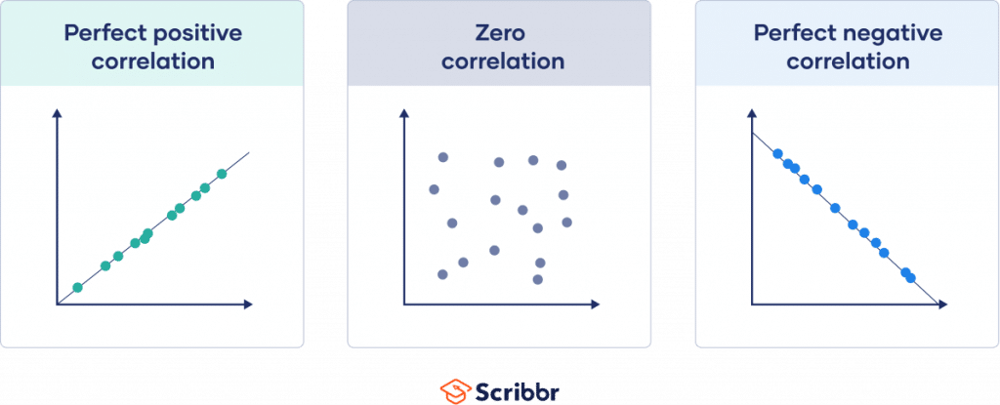

[Read more about Pearson's correlation here](https://www.investopedia.com/terms/c/correlation.asp)


In [ ]:
# Extracting only numerical features from the given dataset
numeric_features=email_df[['Subject_Hotness_Score','Total_Past_Communications','Word_Count','Total_Links','Total_Images']]

In [ ]:
# Calculating the pearson's correlation between features using seaborn heatmap matrix
corr=numeric_features.corr().round(3)
corr.style.background_gradient(cmap='coolwarm')

,Subject_Hotness_Score,Total_Past_Communications,Word_Count,Total_Links,Total_Images
Subject_Hotness_Score,1.000000,-0.419000,-0.238000,-0.028000,-0.020000
Total_Past_Communications,-0.419000,1.000000,-0.345000,0.107000,0.060000
Word_Count,-0.238000,-0.345000,1.000000,0.072000,0.051000
Total_Links,-0.028000,0.107000,0.072000,1.000000,0.753000
Total_Images,-0.020000,0.060000,0.051000,0.753000,1.000000


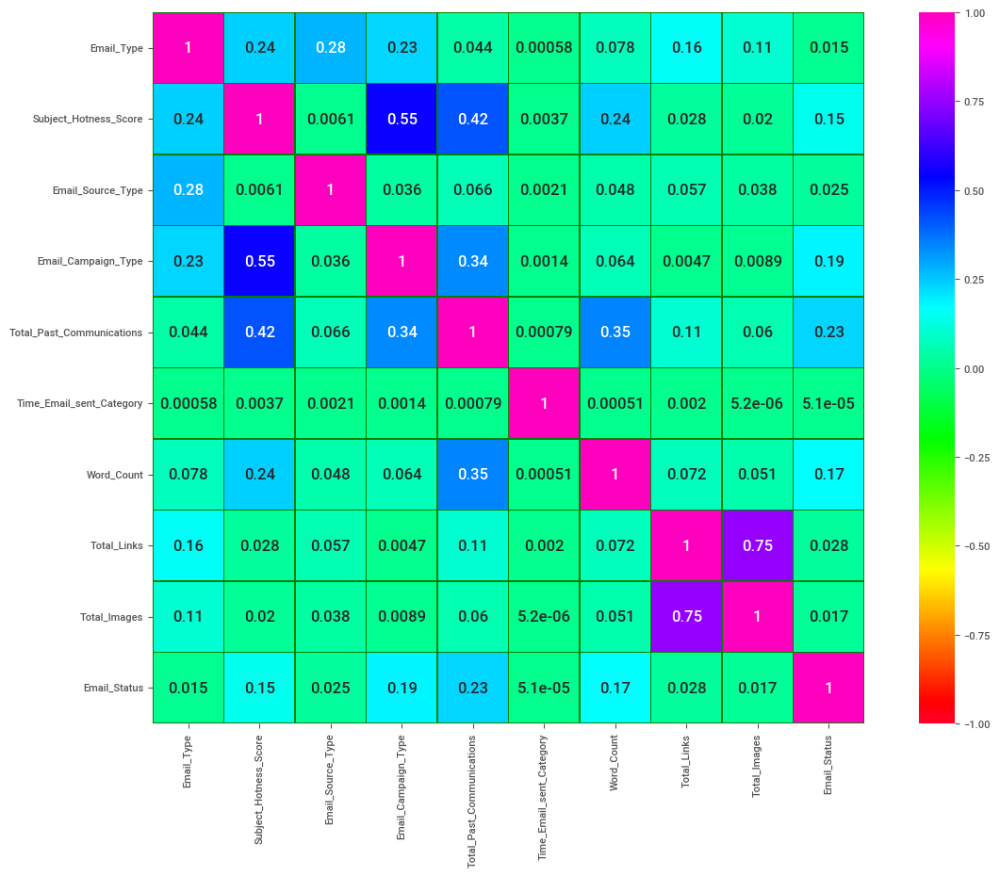

In [ ]:
# Now let's use seaborn heatmap correlation plot
# plt.figure(figsize=(12,10))
# sns.heatmap(numeric_features.corr(),annot=True,annot_kws={"size":15}, vmin=-1, vmax=1, cmap="gist_rainbow",linewidth=0.5,linecolor='g',square=True)
# plt.title("Heatmap Correlation Plot for Numerical Features",fontsize=14)

# plt.show()

## Correlation
plt.figure(figsize=(15,10))
correlation = email_df.corr()
sns.heatmap(abs(correlation), annot=True,annot_kws={"size":12}, vmin=-1, vmax=1, cmap='gist_rainbow',linewidth=0.5,linecolor='g',square=True)
plt.show()



---


# Observations:

---
* ### So we can observe that the correlation score is 0.75 for Total_Images and Total_Links which on a scale of (-1,1) can be understood as high positive correlation.

* ### Total Past communication and Total link sent are positively related with a Pearson's correlation value of 0.11.

* ### To understand whether this relation holds true, we can plot the selected variables using scatter plots.
---




In [ ]:
# Plotting the correlation between total images and total links with respect to target varible
px.scatter(data_frame=email_df, x="Total_Images",y="Total_Links",
           color="Email_Status",title="Correlation between Total Images and Total Links with Target Variable",
           template="plotly_dark",trendline='ols',width=1100,height=500)



---


# Observations:

---


* ### We can conclude from the above information that there is a high positive correlation between these two features. 

* ### Lets now understand each feature individually.

---



In [ ]:
# comparing the outlier between total links and total images
trace1=go.Box(
    x=email_df['Total_Links'],orientation='h', boxpoints='all',
    name="Total_Links"
)    

trace2=go.Box(
    x=email_df['Total_Images'],orientation='h', boxpoints='all',
    name="Total_Images"
)

fig = make_subplots(rows=1, cols=2, x_title="Values",
                    subplot_titles=("Total Links","Total Images"))

fig.append_trace(trace1, 1, 1)
fig.append_trace(trace2, 1, 2)
fig.show()

In [ ]:
# Calculating the percentage of total zero images
zero_total_images=email_df[email_df["Total_Images"]==0].count()["Total_Images"]
total_images=email_df["Total_Images"].count()
Percentage_zero_images=(zero_total_images/total_images)*100
print(f" Percentage of zero images sent is {Percentage_zero_images.round(2)}%")

 Percentage of zero images sent is 53.75%




---


# Observations:

---

* ### When compared to Total_Images, Total_Links has very few outliers.
* ### Since images and links are correlated and most of the values in Total_Images is 0 we will combine both the features.

* ### We already have taken care of null values so we are ready to combine these two features namely total links and total images
---



In [ ]:
# Combining two features 
email_df['Links_Images']=email_df['Total_Links']+email_df['Total_Images']

In [ ]:
#Dropping Total_Images and Total_Links  column
print('Shape of data before dropping ',email_df.shape)
email_df.drop(['Total_Images','Total_Links'],inplace=True,axis=1)
print('Shape of data after dropping ',email_df.shape)

Shape of data before dropping  (68353, 13)
Shape of data after dropping  (68353, 11)


# **Feature Engineering**

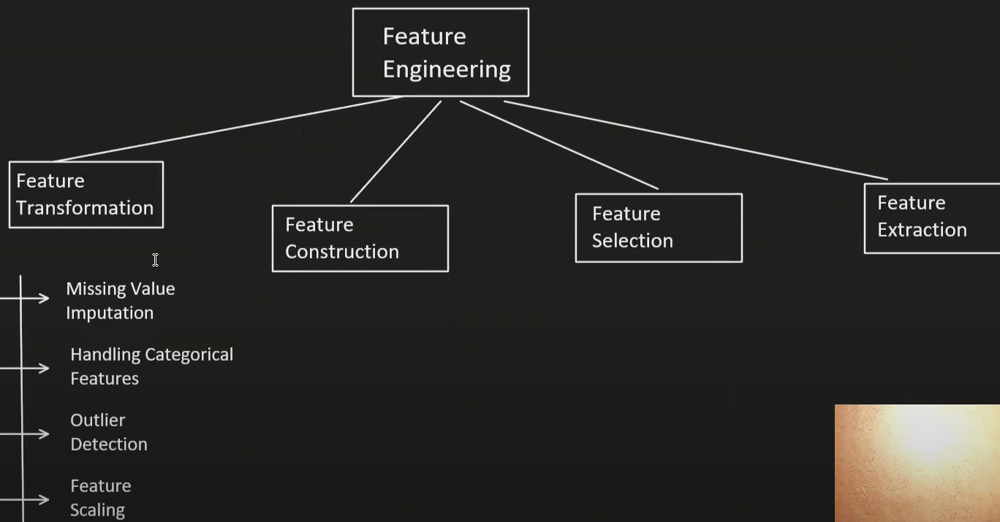

### Lets understand the multicollinearity within the numerical featrures.

In [ ]:
#Multicollinearity
from statsmodels.stats.outliers_influence import variance_inflation_factor
def calc_vif(X):

    # Calculating VIF
    vif = pd.DataFrame()
    vif["variables"] = X.columns
    vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

    return(vif)

In [ ]:
# Listing down new numerical features
new_numerical_features=email_df[["Subject_Hotness_Score","Total_Past_Communications","Word_Count","Links_Images"]]

In [ ]:
calc_vif(new_numerical_features).style.background_gradient(cmap='coolwarm')

,variables,VIF
0,Subject_Hotness_Score,1.734531
1,Total_Past_Communications,3.430879
2,Word_Count,3.687067
3,Links_Images,2.629047


### Except Word_Count column all other numeric column have outliers. Since our dependent variable is highly imbalanced so before dropping outliers we should check that it will not going to delete more than 5% of minority class which is Email_Status =1,2

In [ ]:
numerical_col=['Subject_Hotness_Score','Total_Past_Communications','Word_Count','Links_Images']

{'Subject_Hotness_Score': {0: 170, 1: 76, 2: 1}, 'Total_Past_Communications': {1: 56, 0: 67, 2: 13}, 'Links_Images': {0: 3061, 1: 437, 2: 122}}


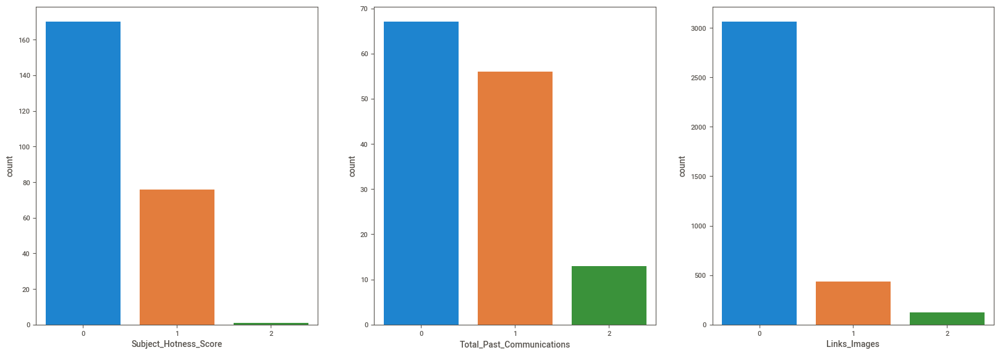

In [ ]:
#removing Word_Count because it does'nt have outlier
numerical_col.remove('Word_Count')

fig = plt.figure(figsize = (20,15))
ix = 1
#dictionary d to store the count of each email_status 
d={}
#iterating through each column which have outlier
for x in [y for y in numerical_col]:
    #Finding Quartile
    q75,q25 = np.percentile(email_df.loc[:,x],[75,25])
    #Calculating Inter Quartile Range
    intr_qr = q75-q25
    #Fixing Boundaries for outliers
    max = q75+(1.5*intr_qr)
    min = q25-(1.5*intr_qr)
    
    #list y to store email_status of only outliers
    y=[]
    y=email_df.loc[email_df[x] < min]['Email_Status'].tolist()
    y.append(email_df.loc[email_df[x] > max]['Email_Status'].tolist()) 
    d[x]={}
    for i in y[0]:
      d[x][i] = d[x].get(i,0) + 1
    ax1 = fig.add_subplot(2,3,ix)
    sns.countplot(y[0],ax=ax1)
    plt.xlabel(x)      
    ix = ix +1
print(d)

In [ ]:
#finding the percentage of minority classs going to be affected by outliers
sum_min=0
sum_maj=0
for x in [y for y in numerical_col]:
  sum_min+=d[x][1]
  sum_min+=d[x][2]
  sum_maj+=d[x][0]
total=email_df.groupby('Email_Status').count()['Email_Type'][1]+email_df.groupby('Email_Status').count()['Email_Type'][2]
total_0=email_df.groupby('Email_Status').count()['Email_Type'][0]
print("Percentage of majority class having outliers = ",(100*sum_maj/total_0).round(2))
print("Percentage of minority class having outliers = ",(100*sum_min/total).round(2))

Percentage of majority class having outliers =  6.0
Percentage of minority class having outliers =  5.26


### Since more than 5% of minority classes will be removed if we delete outliers and we don't want that so we will keep it as it is

In [ ]:
#Dropping Email_ID column
print('Shape of data before dropping ',email_df.shape)
email_df.drop('Email_ID',inplace=True,axis=1)
print('Shape of data after dropping ',email_df.shape)

Shape of data before dropping  (68353, 11)
Shape of data after dropping  (68353, 10)


### Now we are done with outlier treatment and missing value imputation lets move on to our dependent variable.

In [ ]:
px.histogram(data_frame=email_df, x='Email_Status',color='Email_Status',text_auto=True,title="Email Status Target Variable Count")


In [ ]:
email_df.groupby('Email_Status').count()['Email_Type']


Email_Status
0    54941
1    11039
2     2373
Name: Email_Type, dtype: int64

### Dependent variable is highly imbalanced . Before treating that lets normalize our data

In [ ]:
# apply normalization techniques
numerical_col=['Subject_Hotness_Score','Total_Past_Communications','Word_Count','Links_Images']
for column in numerical_col:
    email_df[column] = (email_df[column] - email_df[column].min()) / (email_df[column].max() - email_df[column].min())

In [ ]:
email_df.head()

,Email_Type,Subject_Hotness_Score,Email_Source_Type,Customer_Location,Email_Campaign_Type,Total_Past_Communications,Time_Email_sent_Category,Word_Count,Email_Status,Links_Images
0,1,0.44,2,E,2,0.492537,1,0.313480,0,0.076087
1,2,0.42,1,NaN,2,0.223881,2,0.363636,0,0.043478
2,2,0.02,1,B,3,0.537313,2,0.722571,1,0.043478
3,1,0.60,2,E,2,0.373134,2,0.446708,0,0.163043
4,1,0.00,2,C,3,0.268657,2,0.710815,0,0.032609


In [ ]:
# # Checking Distribution of features after normalization
# plt.figure(figsize=(16,5))
# plt.subplot(1,4,1)
# sns.distplot(email_df['Subject_Hotness_Score'])

# plt.subplot(1,4,2)
# sns.distplot(email_df['Total_Past_Communications'])

# plt.subplot(1,4,3)
# sns.distplot(email_df['Word_Count'])

# plt.subplot(1,4,4)
# sns.distplot(email_df['Links_Images'])

# plt.show()

### Now we are done with scaling ,it's time to perform one-hot encoding on our categorical data.

# OneHotEncoding:
### One hot encoding is a process by which categorical variables are converted into a form that could be provided to ML algorithms to do a better job in prediction.

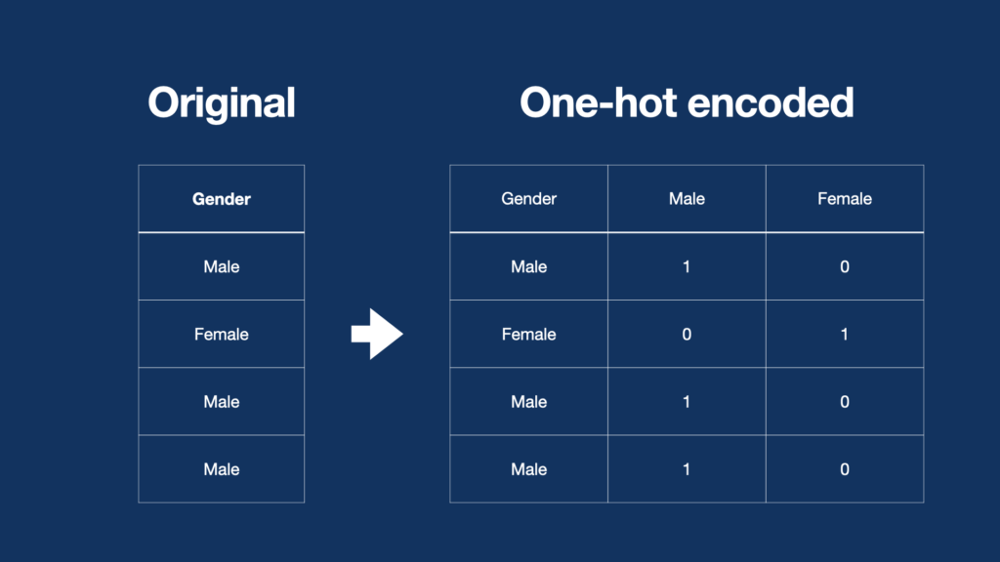

[Read here more about OneHotEncoding](https://datagy.io/pandas-get-dummies/)

In [ ]:
# Performing onehotencoding using pandas get dummy method
cat_col=['Email_Type','Email_Source_Type','Email_Campaign_Type','Time_Email_sent_Category','Customer_Location']
email_df=pd.get_dummies(email_df, columns=cat_col, drop_first=True)

In [ ]:
# Appending target variable at the end of dataframe
list_of_col=list(email_df.columns)
list_of_col.remove('Email_Status')
list_of_col.append('Email_Status')
list_of_col
email_df=email_df[list_of_col]
email_df.head(2)

,Subject_Hotness_Score,Total_Past_Communications,Word_Count,Links_Images,Email_Type_2,Email_Source_Type_2,Email_Campaign_Type_2,Email_Campaign_Type_3,Time_Email_sent_Category_2,Time_Email_sent_Category_3,Customer_Location_B,Customer_Location_C,Customer_Location_D,Customer_Location_E,Customer_Location_F,Customer_Location_G,Email_Status
0,0.44,0.492537,0.313480,0.076087,0,1,1,0,0,0,0,0,0,1,0,0,0
1,0.42,0.223881,0.363636,0.043478,1,0,1,0,1,0,0,0,0,0,0,0,0


In [ ]:
email_df.shape

(68353, 17)

In [ ]:
def compute_impurity(feature):
    """
    This function calculates impurity of a feature.
    input: feature (this needs to be a Pandas series)
    output: feature impurity
    """
    probs = feature.value_counts(normalize=True)
    impurity = -1 * np.sum(np.log2(probs) * probs)   
    return(round(impurity, 3))

In [ ]:
def comp_feature_information_gain(df, target, descriptive_feature):
    """
    This function calculates information gain for splitting on 
    a particular descriptive feature for a given dataset
    and a given impurity criteria.
    Supported split criterion: 'entropy'
    """
    target_entropy = compute_impurity(df[target])

    # we define two lists below:
    # entropy_list to store the entropy of each partition
    # weight_list to store the relative number of observations in each partition
    entropy_list = list()
    weight_list = list()
    
    # loop over each level of the descriptive feature
    # to partition the dataset with respect to that level
    # and compute the entropy and the weight of the level's partition
    for level in df[descriptive_feature].unique():
        df_feature_level = df[df[descriptive_feature] == level]
        entropy_level = compute_impurity(df_feature_level[target])
        entropy_list.append(round(entropy_level, 3))
        weight_level = len(df_feature_level) / len(df)
        weight_list.append(round(weight_level, 3))

    feature_remaining_impurity = np.sum(np.array(entropy_list) * np.array(weight_list))
    
    
    information_gain = target_entropy - feature_remaining_impurity
    

    return(information_gain)

Subject_Hotness_Score : 0.03815999999999997
Total_Past_Communications : 0.08543499999999993
Word_Count : 0.04493199999999986
Links_Images : 0.023570999999999898
Email_Type_2 : 0.00040000000000006697
Email_Source_Type_2 : 4.899999999996574e-05
Email_Campaign_Type_2 : 0.050541999999999976
Email_Campaign_Type_3 : 0.03729300000000002
Time_Email_sent_Category_2 : -0.0006019999999999914
Time_Email_sent_Category_3 : 0.0
Customer_Location_B : -0.0005920000000000369
Customer_Location_C : -0.000496000000000052
Customer_Location_D : -0.0007840000000000069
Customer_Location_E : -0.0005330000000000057
Customer_Location_F : -0.00048000000000003595
Customer_Location_G : -0.00035600000000002296


Text(0.5, 1.0, 'Feature Importance')

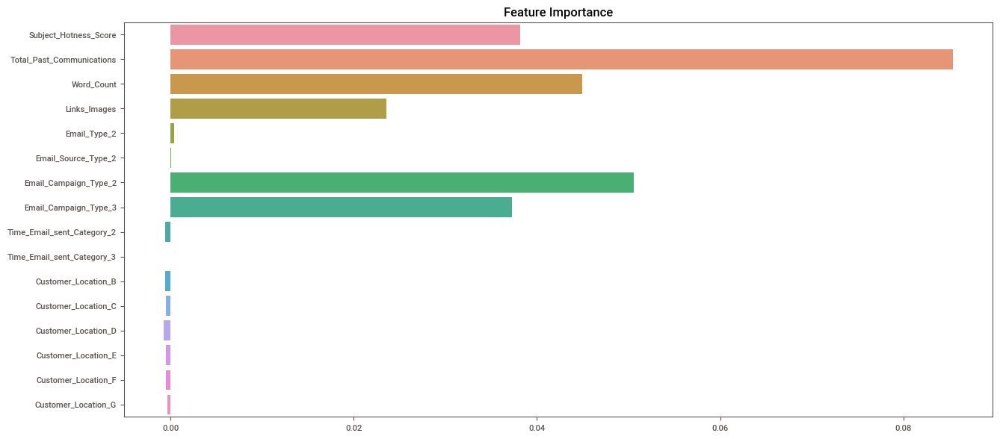

In [ ]:
info_gain={}
for feature in email_df.drop(columns='Email_Status').columns:
    feature_info_gain = comp_feature_information_gain(email_df, 'Email_Status', feature)
    info_gain[feature]=feature_info_gain
    print(feature, ':', feature_info_gain)
keys = list(info_gain.keys())
# get values in the same order as keys, and parse percentage values
vals = [float(info_gain[k]) for k in info_gain]
plt.figure(figsize=(15,7))
sns.barplot(y=keys, x=vals)
plt.title('Feature Importance')

In [ ]:
drop=['Time_Email_sent_Category_2','Time_Email_sent_Category_3','Customer_Location_B',
      'Customer_Location_C','Customer_Location_D',
      'Customer_Location_E','Customer_Location_F','Customer_Location_G']
email_df.drop(drop,inplace=True,axis=1)

In [ ]:
email_df.head(1)

,Subject_Hotness_Score,Total_Past_Communications,Word_Count,Links_Images,Email_Type_2,Email_Source_Type_2,Email_Campaign_Type_2,Email_Campaign_Type_3,Email_Status
0,0.44,0.492537,0.31348,0.076087,0,1,1,0,0


### Now we are done with feature selection lets move to data imbalance handling.

---
 # **Imbalance Class Handling**
---


## Random Under Sampling




### Undersampling can be defined as removing some observations of the majority class. This is done until the majority and minority class is balanced out.

### Undersampling can be a good choice when you have a ton of data -think millions of rows. But a drawback to undersampling is that we are removing information that may be valuable.

---



In [ ]:
#X and Y 
X = email_df.drop('Email_Status',axis=1)
y = email_df['Email_Status']
print(f'Shape of X: {X.shape}')
print(f'Shape of Y: {y.shape}')

Shape of X: (68353, 8)
Shape of Y: (68353,)


In [ ]:
#train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42, stratify=y) 
#we need to stratify to get same proprtion of classes in both the sets

##Random Under Sampling

In [ ]:
#resample
rus = RandomUnderSampler(random_state=42, replacement=True)
x_train_rus, y_train_rus = rus.fit_resample(X_train,y_train)

#print shape
print('Original dataset shape:', len(y_train))
print('Resampled dataset shape', len(y_train_rus))

Original dataset shape: 54682
Resampled dataset shape 5694


Class=0, n=1898 (33.333%)
Class=1, n=1898 (33.333%)
Class=2, n=1898 (33.333%)


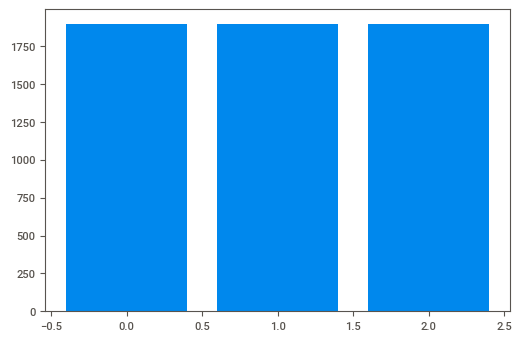

In [ ]:
#visualization of resampled data
def resampled_data_visual(y_train_rus):
  counter = Counter(y_train_rus)
  for key,value in counter.items():
    per = value / len(y_train_rus) * 100
    print('Class=%d, n=%d (%.3f%%)' % (key, value, per))
  # plot the distribution
  plt.bar(counter.keys(), counter.values())
  plt.show()

resampled_data_visual(y_train_rus)

##TomekLinks

In [ ]:
tomek= TomekLinks()
x_train_tomek, y_train_tomek = tomek.fit_resample(X_train, y_train)
print('Original dataset shape', len(y_train))
print('Resampled dataset shape', len(y_train_tomek))

Original dataset shape 54682
Resampled dataset shape 47423


Text(0.5, 1.0, 'After Tomeklinks')

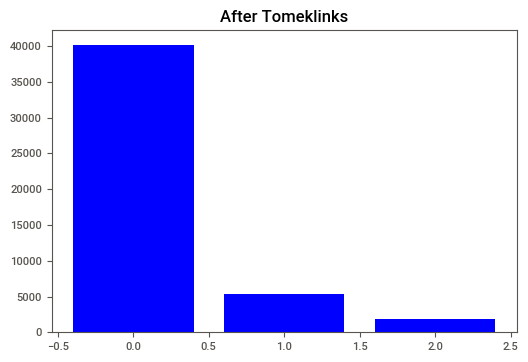

In [ ]:
#resampled_data_visual(y_train_tomek)
plt.bar(Counter(y_train_tomek).keys(), Counter(y_train_tomek).values(), color='b')
plt.title("After Tomeklinks")

In [ ]:
unique_elements, counts_elements = np.unique(y_train_tomek, return_counts=True)
print("Frequency of unique values of the Email_Status:")
print(np.asarray((unique_elements, counts_elements)))

Frequency of unique values of the Email_Status:
[[    0     1     2]
 [40204  5321  1898]]


In [ ]:
smotom= SMOTETomek(random_state=0)
x_train_smotom, y_train_smotom = smotom.fit_resample(X_train, y_train)
print('Original dataset shape', len(y_train))
print('Resampled dataset shape', len(y_train_smotom))

Original dataset shape 54682
Resampled dataset shape 127785


Class=1, n=42342 (33.135%)
Class=0, n=42252 (33.065%)
Class=2, n=43191 (33.800%)


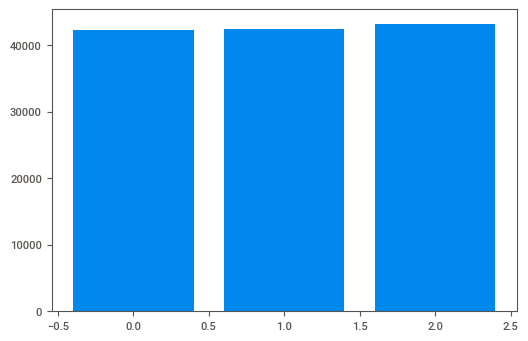

In [ ]:
resampled_data_visual(y_train_smotom)

##Logistic Regression:

In [ ]:
#fitting Undersampling
logistic_rus = LogisticRegression(class_weight='balanced',multi_class='multinomial', solver='lbfgs')
logistic_rus.fit(x_train_rus, y_train_rus)

LogisticRegression(class_weight='balanced', multi_class='multinomial')

In [ ]:
#fitting on smote
logistic_tomek = LogisticRegression(class_weight='balanced',multi_class='multinomial', solver='lbfgs')
logistic_tomek.fit(x_train_tomek, y_train_tomek)

LogisticRegression(class_weight='balanced', multi_class='multinomial')

In [ ]:
#fitting on smotetomek
logistic_smotom= LogisticRegression(class_weight='balanced',multi_class='multinomial', solver='lbfgs')
logistic_smotom.fit(x_train_smotom, y_train_smotom)

LogisticRegression(class_weight='balanced', multi_class='multinomial')

In [ ]:
#Columns needed to compare metrics
comparison_columns = ['Model_Name', 'Train_Accuracy', 'Train_Recall', 'Train_Precision', 'Train_F1score',
                      'Train_AUC' ,'Test_Accuracy', 'Test_Recall', 'Test_Precision', 'Test_F1score', 'Test_AUC']


In [ ]:

#Function to evaluate the model

def model_evaluation(model_name_RUS,model_name_tomek,model_name_somtom,model_var_rus, model_var_tomek,model_var_smotom, x_train_rus, y_train_rus, x_train_tomek, y_train_tomek,
                     x_train_smotom, y_train_smotom, X_test, y_test):
  ''' This function predicts and evaluates various models for clasification for Random Undersampling and SMOTE algorithms, visualizes results 
      and creates a dataframe that compares the various models.'''
  
  #Making predictions random undersampling
  y_pred_rus_train = model_var_rus.predict(x_train_rus)
  y_pred_rus_test = model_var_rus.predict(X_test)
  #probs
  train_rus_proba = model_var_rus.predict_proba(x_train_rus)
  test_rus_proba = model_var_rus.predict_proba(X_test)

  #Making predictions TomekLinks
  y_pred_tomek_train = model_var_tomek.predict(x_train_tomek)
  y_pred_tomek_test = model_var_tomek.predict(X_test)
  #probs
  train_sm_proba = model_var_tomek.predict_proba(x_train_tomek)
  test_sm_proba = model_var_tomek.predict_proba(X_test)

  #Making predictions SmoteTomek
  y_pred_smotom_train = model_var_smotom.predict(x_train_smotom)
  y_pred_smotom_test = model_var_smotom.predict(X_test)
  #probs
  train_smt_proba = model_var_smotom.predict_proba(x_train_smotom)
  test_smt_proba = model_var_smotom.predict_proba(X_test)

  #Evaluation 
  #Accuracy RUS
  accuracy_rus_train = accuracy_score(y_train_rus,y_pred_rus_train)
  accuracy_rus_test = accuracy_score(y_test,y_pred_rus_test)
  #Accuracy TomekLinks
  accuracy_tomek_train = accuracy_score(y_train_tomek,y_pred_tomek_train)
  accuracy_tomek_test = accuracy_score(y_test,y_pred_tomek_test)
  #Accuracy SmoteTomek
  accuracy_smotom_train = accuracy_score(y_train_smotom,y_pred_smotom_train)
  accuracy_smotom_test = accuracy_score(y_test,y_pred_smotom_test)

  #Confusion Matrix RUS
  cm_rus_train = confusion_matrix(y_train_rus,y_pred_rus_train)
  cm_rus_test = confusion_matrix(y_test,y_pred_rus_test)
  #Confusion Matrix TomekLinks
  cm_tomek_train = confusion_matrix(y_train_tomek,y_pred_tomek_train)
  cm_tomek_test = confusion_matrix(y_test,y_pred_tomek_test)
  #Confusion Matrix SmoteTomek
  cm_smotom_train = confusion_matrix(y_train_smotom,y_pred_smotom_train)
  cm_smotom_test = confusion_matrix(y_test,y_pred_smotom_test)

  #Recall RUS
  train_recall_rus = recall_score(y_train_rus,y_pred_rus_train, average='weighted')
  test_recall_rus = recall_score(y_test,y_pred_rus_test, average='weighted')
  #Recall TomekLinks
  train_recall_tomek = recall_score(y_train_tomek,y_pred_tomek_train, average='weighted')
  test_recall_tomek = recall_score(y_test,y_pred_tomek_test, average='weighted')
  #Recall SmoteTomek
  train_recall_smotom = recall_score(y_train_smotom,y_pred_smotom_train, average='weighted')
  test_recall_smotom = recall_score(y_test,y_pred_smotom_test, average='weighted')

 #Precision RUS
  train_precision_rus = precision_score(y_train_rus,y_pred_rus_train, average='weighted')
  test_precision_rus = precision_score(y_test,y_pred_rus_test, average='weighted')
  #Precision TomekLinks
  train_precision_tomek = precision_score(y_train_tomek,y_pred_tomek_train, average='weighted')
  test_precision_tomek = precision_score(y_test,y_pred_tomek_test, average='weighted')
 #Precision SmoteTomek
  train_precision_smotom = precision_score(y_train_smotom,y_pred_smotom_train, average='weighted')
  test_precision_smotom = precision_score(y_test,y_pred_smotom_test, average='weighted')


  #F1 Score RUS
  train_f1_rus = f1_score(y_train_rus,y_pred_rus_train, average='weighted')
  test_f1_rus = f1_score(y_test,y_pred_rus_test, average='weighted')
  #F1 Score TomekLinks
  train_f1_tomek = f1_score(y_train_tomek,y_pred_tomek_train, average='weighted')
  test_f1_tomek = f1_score(y_test,y_pred_tomek_test, average='weighted')
  #F1 Score SmoteTomek
  train_f1_smotom = f1_score(y_train_smotom,y_pred_smotom_train, average='weighted')
  test_f1_smotom = f1_score(y_test,y_pred_smotom_test, average='weighted')

  #ROC-AUC RUS
  train_auc_rus = roc_auc_score(y_train_rus,train_rus_proba,average='weighted',multi_class = 'ovr')
  test_auc_rus = roc_auc_score(y_test,test_rus_proba,average='weighted',multi_class = 'ovr')
  #ROC-AUC TomekLinks
  train_auc_tomek = roc_auc_score(y_train_tomek,train_sm_proba,average='weighted',multi_class = 'ovr')
  test_auc_tomek = roc_auc_score(y_test,test_sm_proba,average='weighted',multi_class = 'ovr')
  #ROC-AUC SmoteTomek
  train_auc_smotom = roc_auc_score(y_train_smotom,train_smt_proba,average='weighted',multi_class = 'ovr')
  test_auc_smotom = roc_auc_score(y_test,test_smt_proba,average='weighted',multi_class = 'ovr')

  #Visualising Results RUS
  print("----- Evaluation on Random Undersampled data -----" + str(model_name_RUS) + "------")
  print("--------------- Train Data ------------\n")
  print("Confusion matrix \n")
  print(cm_rus_train)
  ax= plt.subplot()
  sns.heatmap(cm_rus_train, annot=True, ax = ax)
  ax.set_xlabel('Predicted labels')
  ax.set_ylabel('True labels')
  ax.set_title('Confusion Matrix Train '+ str(model_name_RUS))
  plt.show()
  print(classification_report(y_train_rus,y_pred_rus_train))

  print("--------------Test data ---------------\n")
  print("Confusion matrix \n")
  print(cm_rus_test)
  ax= plt.subplot()
  sns.heatmap(cm_rus_test, annot=True, ax = ax)
  ax.set_xlabel('Predicted labels')
  ax.set_ylabel('True labels')
  ax.set_title('Confusion Matrix Test '+ str(model_name_RUS))
  plt.show()
  print(classification_report(y_test,y_pred_rus_test))
  #create ROC curve
  fpr = {}
  tpr = {}
  thresh ={}
  no_of_class=3
  for i in range(no_of_class):    
      fpr[i], tpr[i], thresh[i] = metrics.roc_curve(y_test, test_rus_proba[:,i], pos_label=i)
  plt.plot(fpr[0], tpr[0], linestyle='--',color='blue', label='Class 0 vs Others'+"AUC="+str(test_auc_rus))
  plt.plot(fpr[1], tpr[1], linestyle='--',color='green', label='Class 1 vs Others'+"AUC="+str(test_auc_rus))
  plt.plot(fpr[2], tpr[2], linestyle='--',color='orange', label='Class 2 vs Others'+"AUC="+str(test_auc_rus))
  plt.title('Multiclass ROC curve of ' + str(model_name_RUS))
  plt.ylabel('True Positive Rate')
  plt.xlabel('False Positive Rate')
  plt.legend(loc=4)
  plt.show()




  #Visualising Results TomekLinks
  print("----- Evaluation on SMOTE data -------" + str(model_name_tomek) + '-----')
  print("--------------- Train Data ------------\n")
  print("Confusion matrix \n")
  print(cm_tomek_train)
  ax= plt.subplot()
  sns.heatmap(cm_tomek_train, annot=True, ax = ax)
  ax.set_xlabel('Predicted labels')
  ax.set_ylabel('True labels')
  ax.set_title('Confusion Matrix Train ' + str(model_name_tomek))
  plt.show()
  print(classification_report(y_train_tomek,y_pred_tomek_train))

  print("---------------Test data ---------------\n")
  print("Confusion matrix \n")
  print(cm_tomek_test)
  ax= plt.subplot()
  sns.heatmap(cm_tomek_test, annot=True, ax = ax)
  ax.set_xlabel('Predicted labels')
  ax.set_ylabel('True labels')
  ax.set_title('Confusion Matrix Test ' + str(model_name_tomek))
  plt.show()
  print(classification_report(y_test,y_pred_tomek_test))
  #create ROC curve
  fpr = {}
  tpr = {}
  thresh ={}
  no_of_class=3
  for i in range(no_of_class):    
      fpr[i], tpr[i], thresh[i] = metrics.roc_curve(y_test, test_sm_proba[:,i], pos_label=i)
  plt.plot(fpr[0], tpr[0], linestyle='--',color='blue', label='Class 0 vs Others'+" AUC="+str(test_auc_tomek))
  plt.plot(fpr[1], tpr[1], linestyle='--',color='green', label='Class 1 vs Others'+" AUC="+str(test_auc_tomek))
  plt.plot(fpr[2], tpr[2], linestyle='--',color='orange', label='Class 2 vs Others'+" AUC="+str(test_auc_tomek))
  plt.title('Multiclass ROC curve of '+ str(model_name_tomek))
  plt.ylabel('True Positive Rate')
  plt.xlabel('False Positive Rate')
  plt.legend(loc=4)
  plt.show()

#Visualising Results SmoteTomek
  print("----- Evaluation on SMOTE data -------" + str(model_name_somtom) + '-----')
  print("--------------- Train Data ------------\n")
  print("Confusion matrix \n")
  print(cm_smotom_train)
  ax= plt.subplot()
  sns.heatmap(cm_smotom_train, annot=True, ax = ax)
  ax.set_xlabel('Predicted labels')
  ax.set_ylabel('True labels')
  ax.set_title('Confusion Matrix Train ' + str(model_name_somtom))
  plt.show()
  print(classification_report(y_train_smotom,y_pred_smotom_train))

  print("---------------Test data ---------------\n")
  print("Confusion matrix \n")
  print(cm_smotom_test)
  ax= plt.subplot()
  sns.heatmap(cm_smotom_test, annot=True, ax = ax)
  ax.set_xlabel('Predicted labels')
  ax.set_ylabel('True labels')
  ax.set_title('Confusion Matrix Test ' + str(model_name_somtom))
  plt.show()
  print(classification_report(y_test,y_pred_smotom_test))
  #create ROC curve
  fpr = {}
  tpr = {}
  thresh ={}
  no_of_class=3
  for i in range(no_of_class):    
      fpr[i], tpr[i], thresh[i] = metrics.roc_curve(y_test, test_smt_proba[:,i], pos_label=i)
  plt.plot(fpr[0], tpr[0], linestyle='--',color='blue', label='Class 0 vs Others'+" AUC="+str(test_auc_smotom))
  plt.plot(fpr[1], tpr[1], linestyle='--',color='green', label='Class 1 vs Others'+" AUC="+str(test_auc_smotom))
  plt.plot(fpr[2], tpr[2], linestyle='--',color='orange', label='Class 2 vs Others'+" AUC="+str(test_auc_smotom))
  plt.title('Multiclass ROC curve of '+ str(model_name_somtom))
  plt.ylabel('True Positive Rate')
  plt.xlabel('False Positive Rate')
  plt.legend(loc=4)
  plt.show()

  #Saving our results
  global comparison_columns
  metric_scores_rus = [model_name_RUS,accuracy_rus_train,train_recall_rus,train_precision_rus,train_f1_rus,train_auc_rus,accuracy_rus_test,test_recall_rus,test_precision_rus,test_f1_rus,test_auc_rus]
  final_dict_rus = dict(zip(comparison_columns,metric_scores_rus))

  metric_scores_tomek = [model_name_tomek,accuracy_tomek_train,train_recall_tomek,train_precision_tomek,train_f1_tomek,train_auc_tomek,accuracy_tomek_test,test_recall_tomek,test_precision_tomek,test_f1_tomek,test_auc_tomek]
  final_dict_tomek = dict(zip(comparison_columns,metric_scores_tomek))

  metric_scores_smotom = [model_name_somtom,accuracy_smotom_train,train_recall_smotom,train_precision_smotom,train_f1_smotom,train_auc_smotom,accuracy_smotom_test,test_recall_smotom,test_precision_smotom,test_f1_smotom,test_auc_smotom]
  final_dict_smotom = dict(zip(comparison_columns,metric_scores_smotom))

  dict_list = [final_dict_rus,final_dict_tomek,final_dict_smotom]
  return dict_list

In [ ]:

#function to create the comparison table
final_list = []
def add_list_to_final_df(dict_list):
  global final_list
  for elem in dict_list:
    final_list.append(elem)
  global comparison_df
  comparison_df = pd.DataFrame(final_list, columns= comparison_columns)

----- Evaluation on Random Undersampled data -----LogisticReg RUS------
--------------- Train Data ------------

Confusion matrix 

[[1335  220  343]
 [ 577  457  864]
 [ 341  267 1290]]


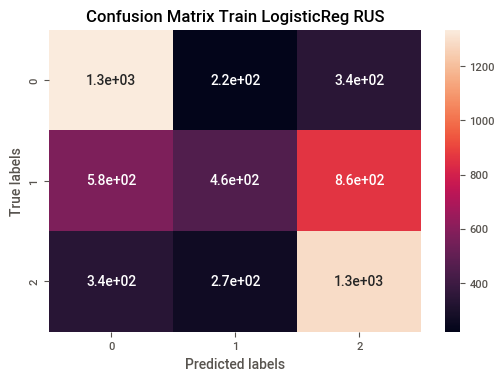

              precision    recall  f1-score   support

           0       0.59      0.70      0.64      1898
           1       0.48      0.24      0.32      1898
           2       0.52      0.68      0.59      1898

    accuracy                           0.54      5694
   macro avg       0.53      0.54      0.52      5694
weighted avg       0.53      0.54      0.52      5694

--------------Test data ---------------

Confusion matrix 

[[7681 1497 1810]
 [ 667  489 1052]
 [  94   60  321]]


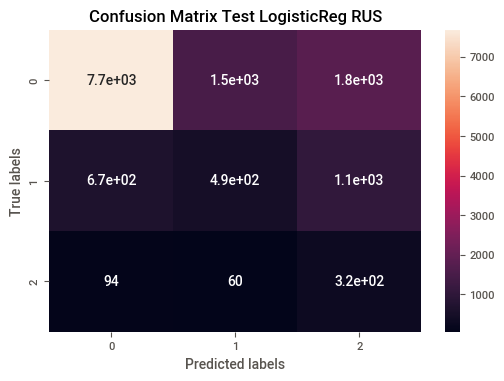

              precision    recall  f1-score   support

           0       0.91      0.70      0.79     10988
           1       0.24      0.22      0.23      2208
           2       0.10      0.68      0.18       475

    accuracy                           0.62     13671
   macro avg       0.42      0.53      0.40     13671
weighted avg       0.77      0.62      0.68     13671



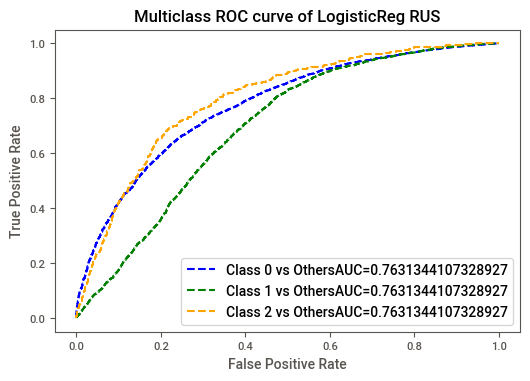

----- Evaluation on SMOTE data -------LogisticReg TomekLinks-----
--------------- Train Data ------------

Confusion matrix 

[[29492  4625  6087]
 [ 1443  1155  2723]
 [  348   258  1292]]


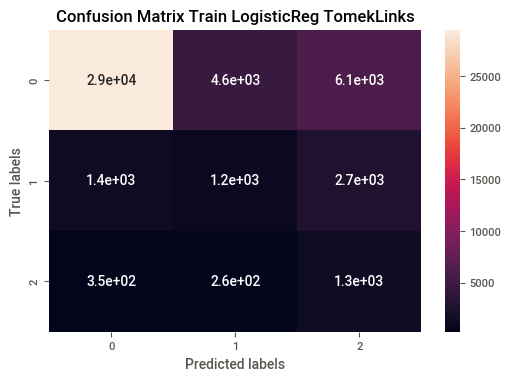

              precision    recall  f1-score   support

           0       0.94      0.73      0.83     40204
           1       0.19      0.22      0.20      5321
           2       0.13      0.68      0.22      1898

    accuracy                           0.67     47423
   macro avg       0.42      0.54      0.41     47423
weighted avg       0.83      0.67      0.73     47423

---------------Test data ---------------

Confusion matrix 

[[7819 1320 1849]
 [ 701  460 1047]
 [  97   63  315]]


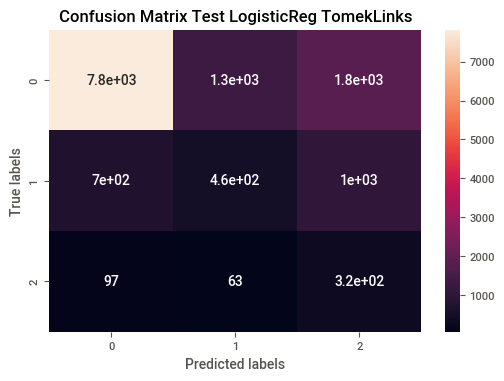

              precision    recall  f1-score   support

           0       0.91      0.71      0.80     10988
           1       0.25      0.21      0.23      2208
           2       0.10      0.66      0.17       475

    accuracy                           0.63     13671
   macro avg       0.42      0.53      0.40     13671
weighted avg       0.77      0.63      0.68     13671



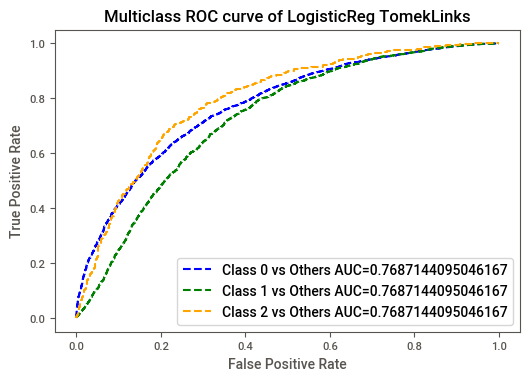

----- Evaluation on SMOTE data -------LogisticReg SMOTETomek-----
--------------- Train Data ------------

Confusion matrix 

[[29782  5548  6922]
 [12821  9232 20289]
 [ 7724  5836 29631]]


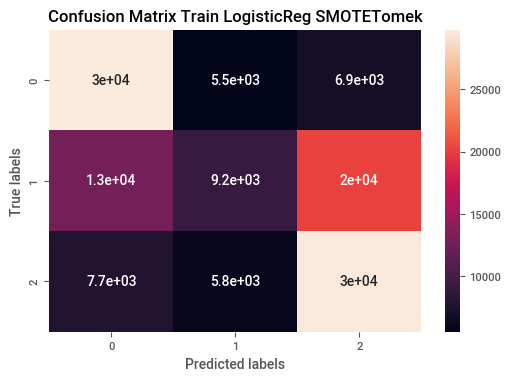

              precision    recall  f1-score   support

           0       0.59      0.70      0.64     42252
           1       0.45      0.22      0.29     42342
           2       0.52      0.69      0.59     43191

    accuracy                           0.54    127785
   macro avg       0.52      0.54      0.51    127785
weighted avg       0.52      0.54      0.51    127785

---------------Test data ---------------

Confusion matrix 

[[7754 1442 1792]
 [ 691  483 1034]
 [  98   63  314]]


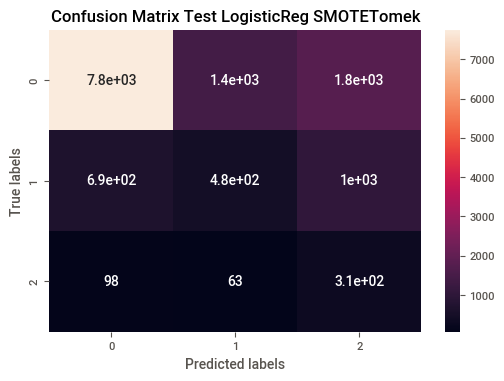

              precision    recall  f1-score   support

           0       0.91      0.71      0.79     10988
           1       0.24      0.22      0.23      2208
           2       0.10      0.66      0.17       475

    accuracy                           0.63     13671
   macro avg       0.42      0.53      0.40     13671
weighted avg       0.77      0.63      0.68     13671



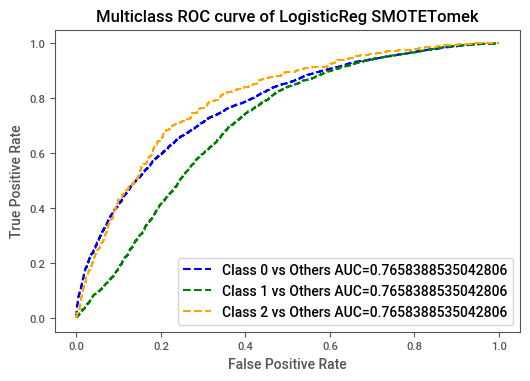

[{'Model_Name': 'LogisticReg RUS',
  'Test_AUC': 0.7631344107328927,
  'Test_Accuracy': 0.6210957501280082,
  'Test_F1score': 0.678696737019222,
  'Test_Precision': 0.773397224807058,
  'Test_Recall': 0.6210957501280082,
  'Train_AUC': 0.7211785056127333,
  'Train_Accuracy': 0.5412715138742537,
  'Train_F1score': 0.517284574053317,
  'Train_Precision': 0.5310911296855783,
  'Train_Recall': 0.5412715138742537},
 {'Model_Name': 'LogisticReg TomekLinks',
  'Test_AUC': 0.7687144095046167,
  'Test_Accuracy': 0.6286299466022969,
  'Test_F1score': 0.6837283693282216,
  'Test_Precision': 0.7730324331081133,
  'Test_Recall': 0.6286299466022969,
  'Train_AUC': 0.8103641128653036,
  'Train_Accuracy': 0.673491765598971,
  'Train_F1score': 0.730935629377796,
  'Train_Precision': 0.8258197652308804,
  'Train_Recall': 0.673491765598971},
 {'Model_Name': 'LogisticReg SMOTETomek',
  'Test_AUC': 0.7658388535042806,
  'Test_Accuracy': 0.6254846024431278,
  'Test_F1score': 0.6814081316730584,
  'Test_Prec

In [ ]:
#Let's evaluate logistic reg
logistic_reg_list = model_evaluation('LogisticReg RUS','LogisticReg TomekLinks','LogisticReg SMOTETomek',logistic_rus, logistic_tomek, logistic_smotom,x_train_rus, y_train_rus, 
                                     x_train_tomek, y_train_tomek,x_train_smotom, y_train_smotom, X_test, y_test)
logistic_reg_list

In [ ]:
add_list_to_final_df(logistic_reg_list)

In [ ]:
#Taking a look of our final comparison dataframe
np.round(comparison_df, decimals = 2).T

,0,1,2
Model_Name,LogisticReg RUS,LogisticReg TomekLinks,LogisticReg SMOTETomek
Train_Accuracy,0.54,0.67,0.54
Train_Recall,0.54,0.67,0.54
Train_Precision,0.53,0.83,0.52
Train_F1score,0.52,0.73,0.51
Train_AUC,0.72,0.81,0.72
Test_Accuracy,0.62,0.63,0.63
Test_Recall,0.62,0.63,0.63
Test_Precision,0.77,0.77,0.77
Test_F1score,0.68,0.68,0.68


Decison Tree Model:

In [ ]:
#Classifier RUS
dt_rus = DecisionTreeClassifier()
dt_rus.fit(x_train_rus,y_train_rus)

DecisionTreeClassifier()

In [ ]:
#Classifier SMOTE
dt_tomek = DecisionTreeClassifier()
dt_tomek.fit(x_train_tomek,y_train_tomek)

DecisionTreeClassifier()

In [ ]:
#Classifier SMOTETomek
dt_smotom = DecisionTreeClassifier()
dt_smotom.fit(x_train_smotom,y_train_smotom)

DecisionTreeClassifier()

----- Evaluation on Random Undersampled data -----Decision Tree RUS------
--------------- Train Data ------------

Confusion matrix 

[[1898    0    0]
 [   3 1895    0]
 [   0    5 1893]]


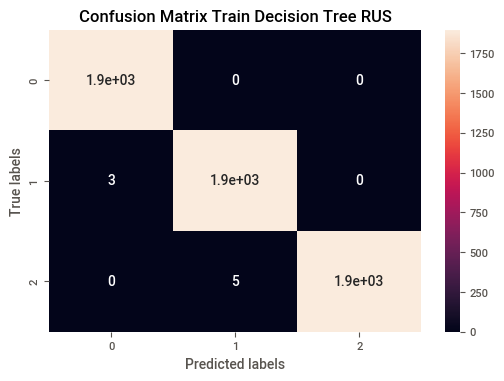

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1898
           1       1.00      1.00      1.00      1898
           2       1.00      1.00      1.00      1898

    accuracy                           1.00      5694
   macro avg       1.00      1.00      1.00      5694
weighted avg       1.00      1.00      1.00      5694

--------------Test data ---------------

Confusion matrix 

[[5784 2855 2349]
 [ 665  730  813]
 [ 119  143  213]]


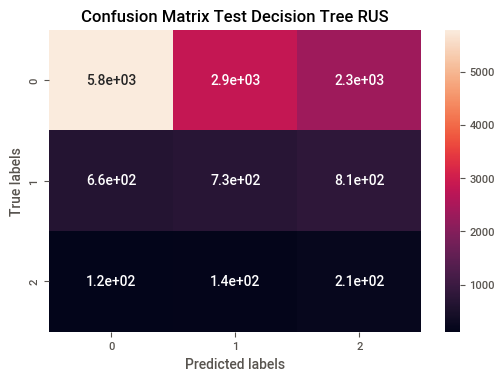

              precision    recall  f1-score   support

           0       0.88      0.53      0.66     10988
           1       0.20      0.33      0.25      2208
           2       0.06      0.45      0.11       475

    accuracy                           0.49     13671
   macro avg       0.38      0.44      0.34     13671
weighted avg       0.74      0.49      0.57     13671



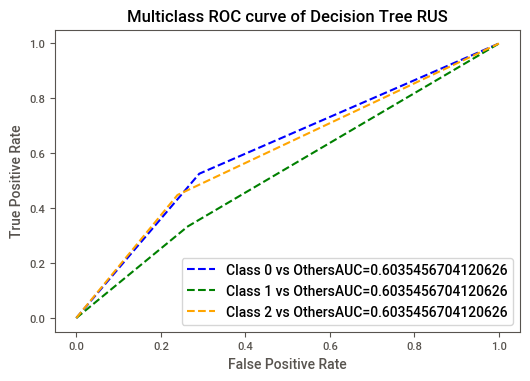

----- Evaluation on SMOTE data -------Decision Tree TomekLinks-----
--------------- Train Data ------------

Confusion matrix 

[[40202     2     0]
 [  103  5217     1]
 [   30    33  1835]]


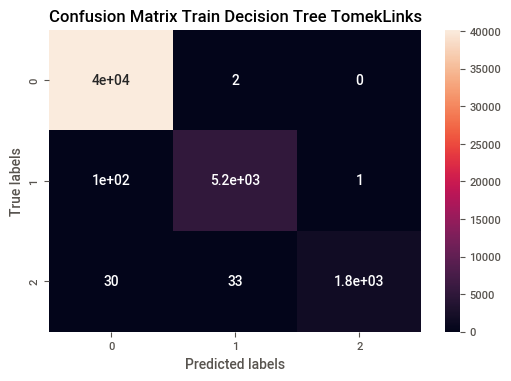

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     40204
           1       0.99      0.98      0.99      5321
           2       1.00      0.97      0.98      1898

    accuracy                           1.00     47423
   macro avg       1.00      0.98      0.99     47423
weighted avg       1.00      1.00      1.00     47423

---------------Test data ---------------

Confusion matrix 

[[9379 1181  428]
 [1430  551  227]
 [ 286  120   69]]


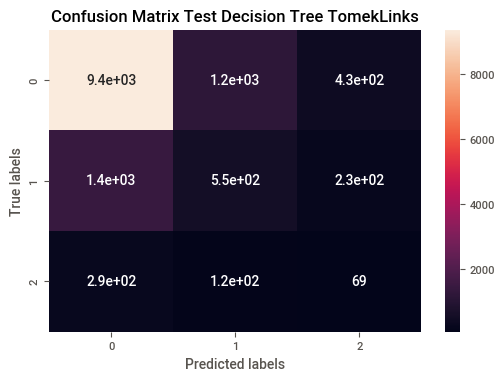

              precision    recall  f1-score   support

           0       0.85      0.85      0.85     10988
           1       0.30      0.25      0.27      2208
           2       0.10      0.15      0.12       475

    accuracy                           0.73     13671
   macro avg       0.41      0.42      0.41     13671
weighted avg       0.73      0.73      0.73     13671



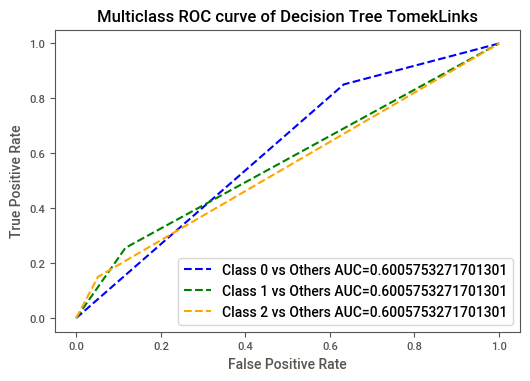

----- Evaluation on SMOTE data -------Decision Tree SMOTETomek-----
--------------- Train Data ------------

Confusion matrix 

[[42250     2     0]
 [  103 42238     1]
 [   30    33 43128]]


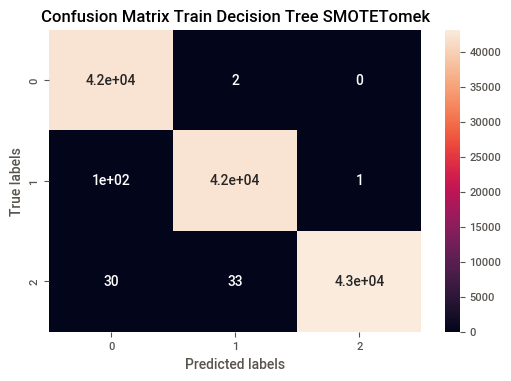

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     42252
           1       1.00      1.00      1.00     42342
           2       1.00      1.00      1.00     43191

    accuracy                           1.00    127785
   macro avg       1.00      1.00      1.00    127785
weighted avg       1.00      1.00      1.00    127785

---------------Test data ---------------

Confusion matrix 

[[8773 1744  471]
 [1271  694  243]
 [ 252  149   74]]


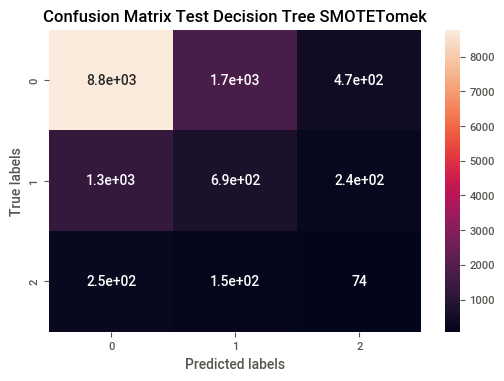

              precision    recall  f1-score   support

           0       0.85      0.80      0.82     10988
           1       0.27      0.31      0.29      2208
           2       0.09      0.16      0.12       475

    accuracy                           0.70     13671
   macro avg       0.40      0.42      0.41     13671
weighted avg       0.73      0.70      0.71     13671



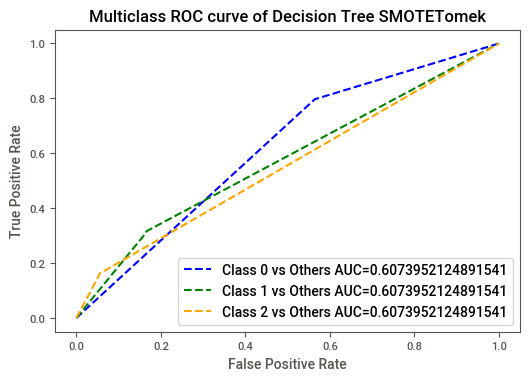

[{'Model_Name': 'Decision Tree RUS',
  'Test_AUC': 0.6035456704120626,
  'Test_Accuracy': 0.49206349206349204,
  'Test_F1score': 0.5731727363223285,
  'Test_Precision': 0.7416237148407957,
  'Test_Recall': 0.49206349206349204,
  'Train_AUC': 0.9999977329953369,
  'Train_Accuracy': 0.9985950122936424,
  'Train_F1score': 0.9985950111715804,
  'Train_Precision': 0.9985967680906632,
  'Train_Recall': 0.9985950122936424},
 {'Model_Name': 'Decision Tree TomekLinks',
  'Test_AUC': 0.6005753271701301,
  'Test_Accuracy': 0.7314022383146808,
  'Test_F1score': 0.7305639857452392,
  'Test_Precision': 0.7307976139211226,
  'Test_Recall': 0.7314022383146808,
  'Train_AUC': 0.9999675785019624,
  'Train_Accuracy': 0.9964363283638741,
  'Train_F1score': 0.996417875226831,
  'Train_Precision': 0.9964350286457061,
  'Train_Recall': 0.9964363283638741},
 {'Model_Name': 'Decision Tree SMOTETomek',
  'Test_AUC': 0.6073952124891541,
  'Test_Accuracy': 0.6979006656426011,
  'Test_F1score': 0.713410920327624,


In [ ]:
dt_eval_list = model_evaluation('Decision Tree RUS', 'Decision Tree TomekLinks','Decision Tree SMOTETomek', dt_rus, dt_tomek, dt_smotom,x_train_rus, y_train_rus,
                                x_train_tomek, y_train_tomek, x_train_smotom,y_train_smotom,X_test, y_test)
dt_eval_list

In [ ]:
#adding list
add_list_to_final_df(dt_eval_list)
#Taking a look of our final comparison dataframe
comparison_df

,Model_Name,Train_Accuracy,Train_Recall,Train_Precision,Train_F1score,Train_AUC,Test_Accuracy,Test_Recall,Test_Precision,Test_F1score,Test_AUC
0,LogisticReg RUS,0.541272,0.541272,0.531091,0.517285,0.721179,0.621096,0.621096,0.773397,0.678697,0.763134
1,LogisticReg TomekLinks,0.673492,0.673492,0.825820,0.730936,0.810364,0.628630,0.628630,0.773032,0.683728,0.768714
2,LogisticReg SMOTETomek,0.537191,0.537191,0.520244,0.510151,0.722263,0.625485,0.625485,0.772229,0.681408,0.765839
3,Decision Tree RUS,0.998595,0.998595,0.998597,0.998595,0.999998,0.492063,0.492063,0.741624,0.573173,0.603546
4,Decision Tree TomekLinks,0.996436,0.996436,0.996435,0.996418,0.999968,0.731402,0.731402,0.730798,0.730564,0.600575
5,Decision Tree SMOTETomek,0.998677,0.998677,0.998680,0.998678,0.999998,0.697901,0.697901,0.731444,0.713411,0.607395


Random Forest Model:

In [ ]:
#RUS
rf_rus = RandomForestClassifier(random_state=42, max_depth=5, n_estimators=100, oob_score=True)
rf_rus.fit(x_train_rus,y_train_rus)

RandomForestClassifier(max_depth=5, oob_score=True, random_state=42)

In [ ]:
#SMOTE
rf_tomek = RandomForestClassifier(random_state=42, max_depth=5, n_estimators=100, oob_score=True)
rf_tomek.fit(x_train_tomek,y_train_tomek)

RandomForestClassifier(max_depth=5, oob_score=True, random_state=42)

In [ ]:
#SMOTETomek
rf_smotom = RandomForestClassifier(random_state=42, max_depth=5, n_estimators=100, oob_score=True)
rf_smotom.fit(x_train_smotom,y_train_smotom)

RandomForestClassifier(max_depth=5, oob_score=True, random_state=42)

----- Evaluation on Random Undersampled data -----Random Forest RUS------
--------------- Train Data ------------

Confusion matrix 

[[1381  186  331]
 [ 542  501  855]
 [ 307  262 1329]]


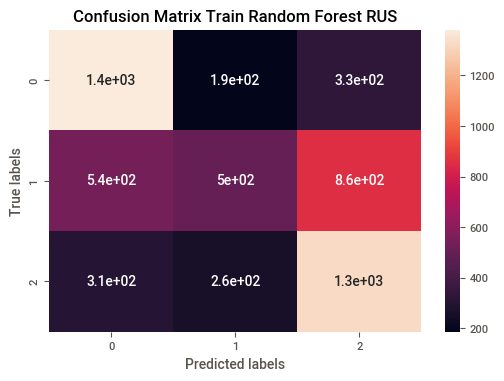

              precision    recall  f1-score   support

           0       0.62      0.73      0.67      1898
           1       0.53      0.26      0.35      1898
           2       0.53      0.70      0.60      1898

    accuracy                           0.56      5694
   macro avg       0.56      0.56      0.54      5694
weighted avg       0.56      0.56      0.54      5694

--------------Test data ---------------

Confusion matrix 

[[7807 1313 1868]
 [ 701  469 1038]
 [  90   64  321]]


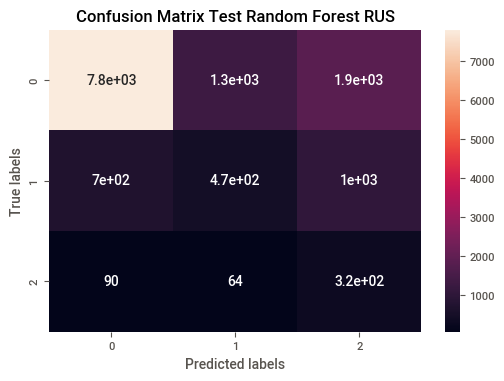

              precision    recall  f1-score   support

           0       0.91      0.71      0.80     10988
           1       0.25      0.21      0.23      2208
           2       0.10      0.68      0.17       475

    accuracy                           0.63     13671
   macro avg       0.42      0.53      0.40     13671
weighted avg       0.77      0.63      0.68     13671



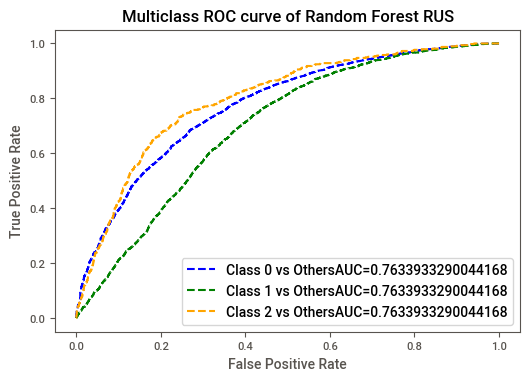

----- Evaluation on SMOTE data -------Random Forest TomekLinks-----
--------------- Train Data ------------

Confusion matrix 

[[40160    44     0]
 [ 4979   342     0]
 [ 1753   145     0]]


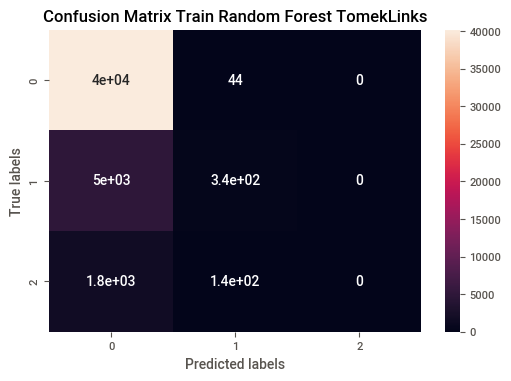

              precision    recall  f1-score   support

           0       0.86      1.00      0.92     40204
           1       0.64      0.06      0.12      5321
           2       0.00      0.00      0.00      1898

    accuracy                           0.85     47423
   macro avg       0.50      0.35      0.35     47423
weighted avg       0.80      0.85      0.79     47423

---------------Test data ---------------

Confusion matrix 

[[10971    17     0]
 [ 2113    95     0]
 [  441    34     0]]


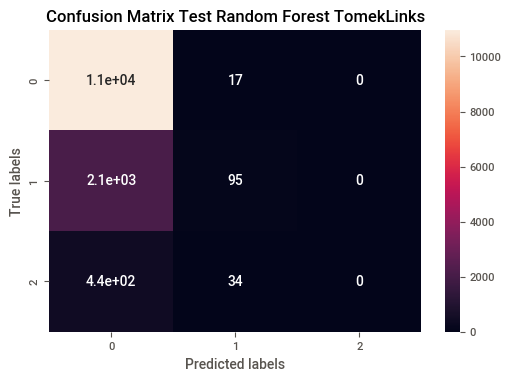

              precision    recall  f1-score   support

           0       0.81      1.00      0.90     10988
           1       0.65      0.04      0.08      2208
           2       0.00      0.00      0.00       475

    accuracy                           0.81     13671
   macro avg       0.49      0.35      0.33     13671
weighted avg       0.76      0.81      0.73     13671



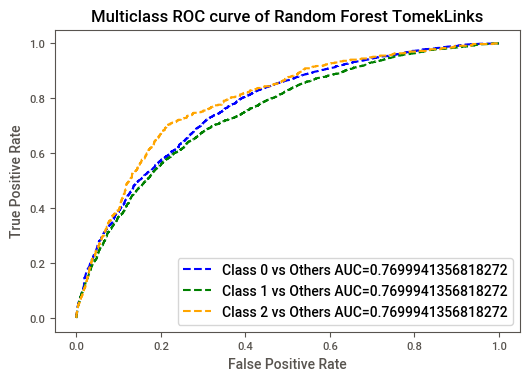

----- Evaluation on SMOTE data -------Random Forest SMOTETomek-----
--------------- Train Data ------------

Confusion matrix 

[[31903  5105  5244]
 [13034 10581 18727]
 [ 6974  6561 29656]]


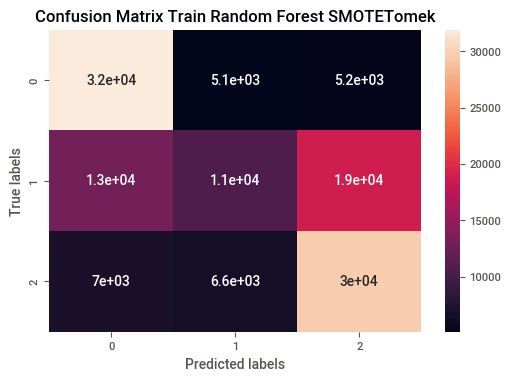

              precision    recall  f1-score   support

           0       0.61      0.76      0.68     42252
           1       0.48      0.25      0.33     42342
           2       0.55      0.69      0.61     43191

    accuracy                           0.56    127785
   macro avg       0.55      0.56      0.54    127785
weighted avg       0.55      0.56      0.54    127785

---------------Test data ---------------

Confusion matrix 

[[8347 1271 1370]
 [ 813  515  880]
 [ 104   86  285]]


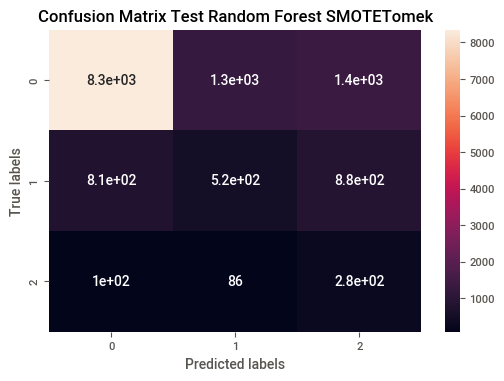

              precision    recall  f1-score   support

           0       0.90      0.76      0.82     10988
           1       0.28      0.23      0.25      2208
           2       0.11      0.60      0.19       475

    accuracy                           0.67     13671
   macro avg       0.43      0.53      0.42     13671
weighted avg       0.77      0.67      0.71     13671



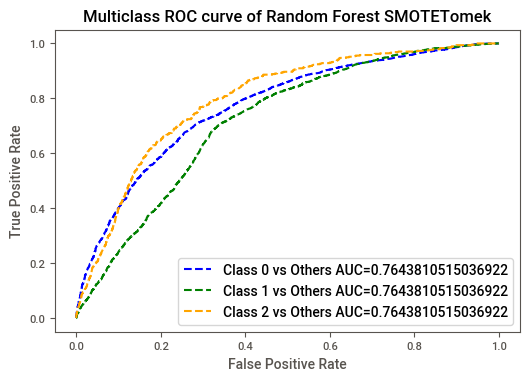

[{'Model_Name': 'Random Forest RUS',
  'Test_AUC': 0.7633933290044168,
  'Test_Accuracy': 0.6288493892180528,
  'Test_F1score': 0.6841423460808492,
  'Test_Precision': 0.7742919290976689,
  'Test_Recall': 0.6288493892180528,
  'Train_AUC': 0.7515154694846368,
  'Train_Accuracy': 0.5639269406392694,
  'Train_F1score': 0.5411166401835343,
  'Train_Precision': 0.5585453551112878,
  'Train_Recall': 0.5639269406392694},
 {'Model_Name': 'Random Forest TomekLinks',
  'Test_AUC': 0.7699941356818272,
  'Test_Accuracy': 0.8094506619852242,
  'Test_F1score': 0.7324818992553263,
  'Test_Precision': 0.7570615146276843,
  'Test_Recall': 0.8094506619852242,
  'Train_AUC': 0.8183233544573018,
  'Train_Accuracy': 0.8540581574341565,
  'Train_F1score': 0.7949327462075215,
  'Train_Precision': 0.7983307748842298,
  'Train_Recall': 0.8540581574341565},
 {'Model_Name': 'Random Forest SMOTETomek',
  'Test_AUC': 0.7643810515036922,
  'Test_Accuracy': 0.6690805354399825,
  'Test_F1score': 0.7098910317771052,


In [ ]:
#Random Forest Evaluation
rf_eval_list = model_evaluation('Random Forest RUS', 'Random Forest TomekLinks','Random Forest SMOTETomek', rf_rus, rf_tomek,rf_smotom, x_train_rus, y_train_rus,
                                x_train_tomek, y_train_tomek,x_train_smotom,y_train_smotom, X_test, y_test)
rf_eval_list

In [ ]:
#adding list
add_list_to_final_df(rf_eval_list)
#Taking a look of our final comparison dataframe
comparison_df

,Model_Name,Train_Accuracy,Train_Recall,Train_Precision,Train_F1score,Train_AUC,Test_Accuracy,Test_Recall,Test_Precision,Test_F1score,Test_AUC
0,LogisticReg RUS,0.541272,0.541272,0.531091,0.517285,0.721179,0.621096,0.621096,0.773397,0.678697,0.763134
1,LogisticReg TomekLinks,0.673492,0.673492,0.825820,0.730936,0.810364,0.628630,0.628630,0.773032,0.683728,0.768714
2,LogisticReg SMOTETomek,0.537191,0.537191,0.520244,0.510151,0.722263,0.625485,0.625485,0.772229,0.681408,0.765839
3,Decision Tree RUS,0.998595,0.998595,0.998597,0.998595,0.999998,0.492063,0.492063,0.741624,0.573173,0.603546
4,Decision Tree TomekLinks,0.996436,0.996436,0.996435,0.996418,0.999968,0.731402,0.731402,0.730798,0.730564,0.600575
5,Decision Tree SMOTETomek,0.998677,0.998677,0.998680,0.998678,0.999998,0.697901,0.697901,0.731444,0.713411,0.607395
6,Random Forest RUS,0.563927,0.563927,0.558545,0.541117,0.751515,0.628849,0.628849,0.774292,0.684142,0.763393
7,Random Forest TomekLinks,0.854058,0.854058,0.798331,0.794933,0.818323,0.809451,0.809451,0.757062,0.732482,0.769994
8,Random Forest SMOTETomek,0.564542,0.564542,0.547718,0.539679,0.759181,0.669081,0.669081,0.772525,0.709891,0.764381


Random Forest Hyperparameter Tuning:

In [ ]:
#classifier
rf = RandomForestClassifier(random_state=42, n_jobs=-1)

In [ ]:
#Parameter dictionary
params = {'max_depth': [3,5,10,20],'min_samples_leaf': [5,10,20,50,100],'n_estimators': [10,25,30,50,100,200]}

In [ ]:
#Grid Search to get the best parameters
grid_search = GridSearchCV(estimator=rf, param_grid=params, cv = 4, n_jobs=-1, verbose=1, scoring="f1_weighted")

In [ ]:
#Fitting RUS to grid search
grid_search.fit(x_train_rus,y_train_rus)

Fitting 4 folds for each of 120 candidates, totalling 480 fits


GridSearchCV(cv=4, estimator=RandomForestClassifier(n_jobs=-1, random_state=42),
             n_jobs=-1,
             param_grid={'max_depth': [3, 5, 10, 20],
                         'min_samples_leaf': [5, 10, 20, 50, 100],
                         'n_estimators': [10, 25, 30, 50, 100, 200]},
             scoring='f1_weighted', verbose=1)

In [ ]:
#optimal model
rf_tuned_rus = grid_search.best_estimator_

In [ ]:
#Fitting TomekLinks
grid_search_tomek = GridSearchCV(estimator=rf, param_grid=params, cv = 4, n_jobs=-1, verbose=1, scoring="f1_weighted")
grid_search_tomek.fit(x_train_tomek,y_train_tomek)
#optimal TomekLinks model
rf_tuned_tomek = grid_search_tomek.best_estimator_

Fitting 4 folds for each of 120 candidates, totalling 480 fits


In [ ]:
#Fitting SMOTETomek
grid_search_smotom = GridSearchCV(estimator=rf, param_grid=params, cv = 4, n_jobs=-1, verbose=1, scoring="f1_weighted")
grid_search_smotom.fit(x_train_smotom,y_train_smotom)
#optimal SMOTETomek model
rf_tuned_smotom = grid_search_smotom.best_estimator_

Fitting 4 folds for each of 120 candidates, totalling 480 fits


----- Evaluation on Random Undersampled data -----RandomF Tuned RUS------
--------------- Train Data ------------

Confusion matrix 

[[1497  169  232]
 [ 290 1237  371]
 [ 221  199 1478]]


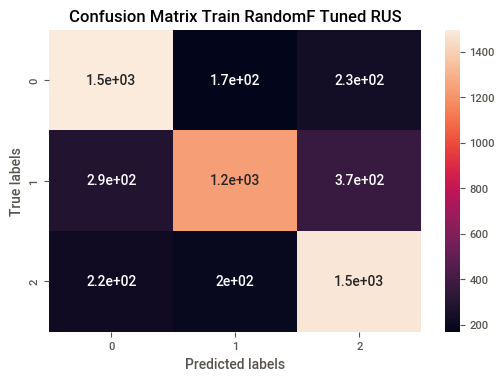

              precision    recall  f1-score   support

           0       0.75      0.79      0.77      1898
           1       0.77      0.65      0.71      1898
           2       0.71      0.78      0.74      1898

    accuracy                           0.74      5694
   macro avg       0.74      0.74      0.74      5694
weighted avg       0.74      0.74      0.74      5694

--------------Test data ---------------

Confusion matrix 

[[7420 2078 1490]
 [ 603  733  872]
 [  74  123  278]]


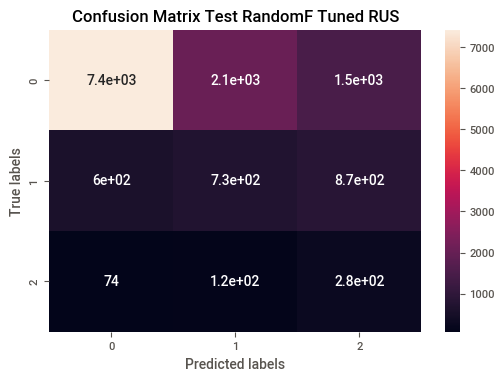

              precision    recall  f1-score   support

           0       0.92      0.68      0.78     10988
           1       0.25      0.33      0.29      2208
           2       0.11      0.59      0.18       475

    accuracy                           0.62     13671
   macro avg       0.42      0.53      0.41     13671
weighted avg       0.78      0.62      0.68     13671



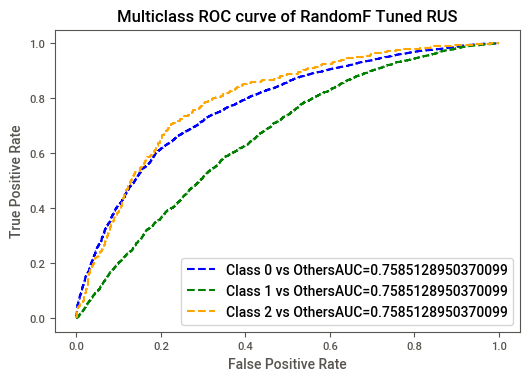

----- Evaluation on SMOTE data -------RandomF Tuned TomekLinks-----
--------------- Train Data ------------

Confusion matrix 

[[39971   219    14]
 [ 3618  1672    31]
 [ 1372   323   203]]


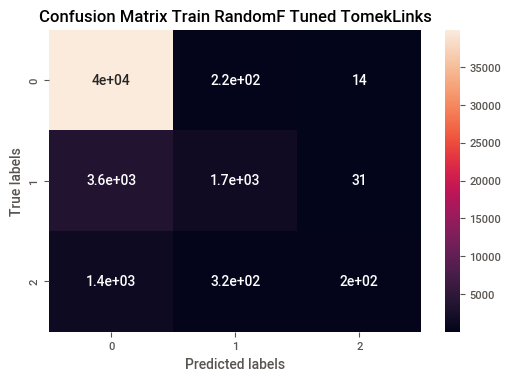

              precision    recall  f1-score   support

           0       0.89      0.99      0.94     40204
           1       0.76      0.31      0.44      5321
           2       0.82      0.11      0.19      1898

    accuracy                           0.88     47423
   macro avg       0.82      0.47      0.52     47423
weighted avg       0.87      0.88      0.85     47423

---------------Test data ---------------

Confusion matrix 

[[10720   257    11]
 [ 1872   302    34]
 [  370    93    12]]


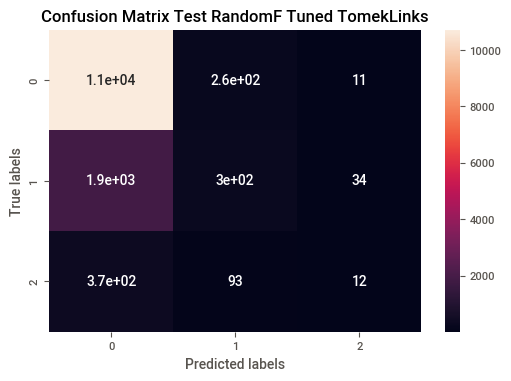

              precision    recall  f1-score   support

           0       0.83      0.98      0.90     10988
           1       0.46      0.14      0.21      2208
           2       0.21      0.03      0.05       475

    accuracy                           0.81     13671
   macro avg       0.50      0.38      0.38     13671
weighted avg       0.75      0.81      0.76     13671



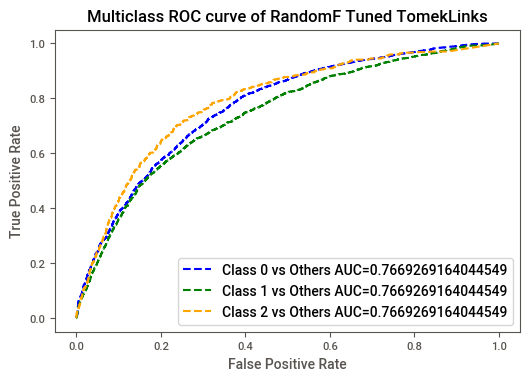

----- Evaluation on SMOTE data -------RandomF Tuned SMOTETomek-----
--------------- Train Data ------------

Confusion matrix 

[[38314  2926  1012]
 [ 3531 35767  3044]
 [  735   849 41607]]


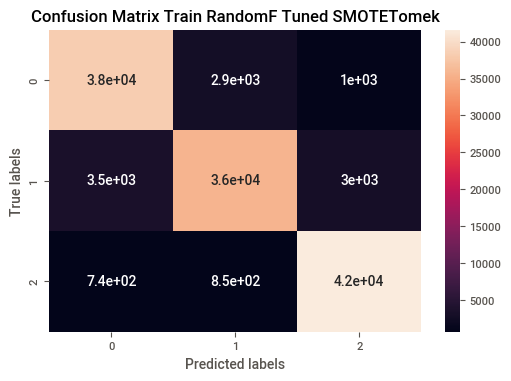

              precision    recall  f1-score   support

           0       0.90      0.91      0.90     42252
           1       0.90      0.84      0.87     42342
           2       0.91      0.96      0.94     43191

    accuracy                           0.91    127785
   macro avg       0.91      0.90      0.90    127785
weighted avg       0.91      0.91      0.90    127785

---------------Test data ---------------

Confusion matrix 

[[9307 1322  359]
 [1137  771  300]
 [ 196  204   75]]


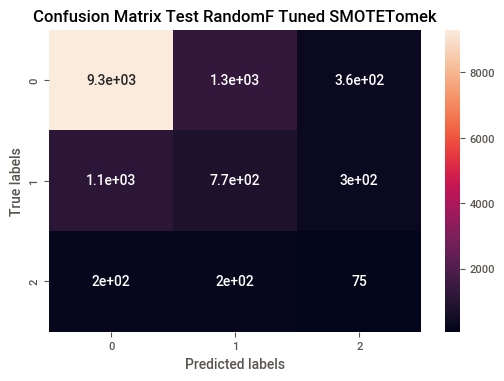

              precision    recall  f1-score   support

           0       0.87      0.85      0.86     10988
           1       0.34      0.35      0.34      2208
           2       0.10      0.16      0.12       475

    accuracy                           0.74     13671
   macro avg       0.44      0.45      0.44     13671
weighted avg       0.76      0.74      0.75     13671



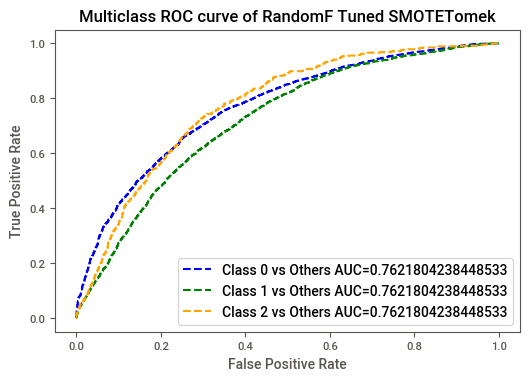

[{'Model_Name': 'RandomF Tuned RUS',
  'Test_AUC': 0.7585128950370099,
  'Test_Accuracy': 0.6167068978128886,
  'Test_F1score': 0.6772199637249591,
  'Test_Precision': 0.7805517256612483,
  'Test_Recall': 0.6167068978128886,
  'Train_AUC': 0.9097218598099123,
  'Train_Accuracy': 0.7397260273972602,
  'Train_F1score': 0.738555022402702,
  'Train_Precision': 0.742156634303215,
  'Train_Recall': 0.7397260273972602},
 {'Model_Name': 'RandomF Tuned TomekLinks',
  'Test_AUC': 0.7669269164044549,
  'Test_Accuracy': 0.8071099407504937,
  'Test_F1score': 0.7551878220296762,
  'Test_Precision': 0.7468481493878283,
  'Test_Recall': 0.8071099407504937,
  'Train_AUC': 0.9449990889512111,
  'Train_Accuracy': 0.8823988360078443,
  'Train_F1score': 0.8531490257893474,
  'Train_Precision': 0.8711795812631837,
  'Train_Recall': 0.8823988360078443},
 {'Model_Name': 'RandomF Tuned SMOTETomek',
  'Test_AUC': 0.7621804238448533,
  'Test_Accuracy': 0.742666959256821,
  'Test_F1score': 0.751331522795447,
  'T

In [ ]:
#Model Evaluation for Random Forest Hyperparameter Tuned
rf_tuned_list = model_evaluation('RandomF Tuned RUS', 'RandomF Tuned TomekLinks','RandomF Tuned SMOTETomek',rf_tuned_rus, rf_tuned_tomek,rf_tuned_smotom,x_train_rus, y_train_rus,
                                 x_train_tomek, y_train_tomek,x_train_smotom,y_train_smotom, X_test, y_test)
rf_tuned_list

In [ ]:
#adding list
add_list_to_final_df(rf_tuned_list)
#Taking a look of our final comparison dataframe
comparison_df

,Model_Name,Train_Accuracy,Train_Recall,Train_Precision,Train_F1score,Train_AUC,Test_Accuracy,Test_Recall,Test_Precision,Test_F1score,Test_AUC
0,LogisticReg RUS,0.541272,0.541272,0.531091,0.517285,0.721179,0.621096,0.621096,0.773397,0.678697,0.763134
1,LogisticReg TomekLinks,0.673492,0.673492,0.825820,0.730936,0.810364,0.628630,0.628630,0.773032,0.683728,0.768714
2,LogisticReg SMOTETomek,0.537191,0.537191,0.520244,0.510151,0.722263,0.625485,0.625485,0.772229,0.681408,0.765839
3,Decision Tree RUS,0.998595,0.998595,0.998597,0.998595,0.999998,0.492063,0.492063,0.741624,0.573173,0.603546
4,Decision Tree TomekLinks,0.996436,0.996436,0.996435,0.996418,0.999968,0.731402,0.731402,0.730798,0.730564,0.600575
5,Decision Tree SMOTETomek,0.998677,0.998677,0.998680,0.998678,0.999998,0.697901,0.697901,0.731444,0.713411,0.607395
6,Random Forest RUS,0.563927,0.563927,0.558545,0.541117,0.751515,0.628849,0.628849,0.774292,0.684142,0.763393
7,Random Forest TomekLinks,0.854058,0.854058,0.798331,0.794933,0.818323,0.809451,0.809451,0.757062,0.732482,0.769994
8,Random Forest SMOTETomek,0.564542,0.564542,0.547718,0.539679,0.759181,0.669081,0.669081,0.772525,0.709891,0.764381
9,RandomF Tuned RUS,0.739726,0.739726,0.742157,0.738555,0.909722,0.616707,0.616707,0.780552,0.677220,0.758513


Random Forest HyperParameter Tuned Feature Importance:

In [ ]:
#feature importance by random forest 
feature_imp = pd.DataFrame({"Variable": x_train_smotom.columns,"Importance": rf_tuned_smotom.feature_importances_})
feature_imp.sort_values(by="Importance", ascending=False, inplace = True)

In [ ]:
feature_imp

,Variable,Importance
1,Total_Past_Communications,0.257740
2,Word_Count,0.223705
0,Subject_Hotness_Score,0.206260
3,Links_Images,0.196480
6,Email_Campaign_Type_2,0.052016
7,Email_Campaign_Type_3,0.031390
4,Email_Type_2,0.018419
5,Email_Source_Type_2,0.013990


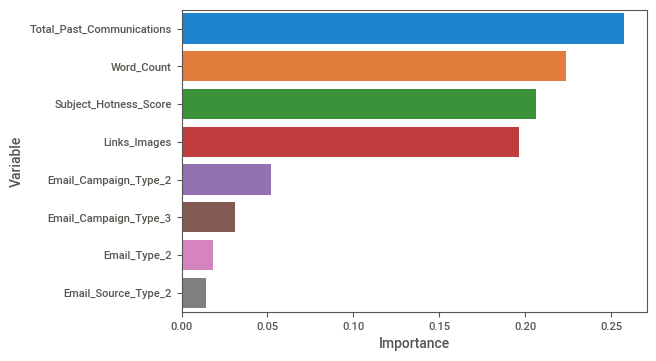

In [ ]:
#visualisation
sns.barplot(x=feature_imp['Importance'],y= feature_imp['Variable'])

KNN Classification Model:

In [ ]:
#RUS fitting
knn_rus = KNeighborsClassifier()
knn_rus.fit(x_train_rus,y_train_rus)

KNeighborsClassifier()

In [ ]:
#TomekLinks fitting
knn_tomek = KNeighborsClassifier()
knn_tomek.fit(x_train_tomek,y_train_tomek)

KNeighborsClassifier()

In [ ]:
#SMOTETomek fitting
knn_smotom = KNeighborsClassifier()
knn_smotom.fit(x_train_smotom,y_train_smotom)

KNeighborsClassifier()

----- Evaluation on Random Undersampled data -----KNN RUS------
--------------- Train Data ------------

Confusion matrix 

[[1473  284  141]
 [ 459 1105  334]
 [ 321  463 1114]]


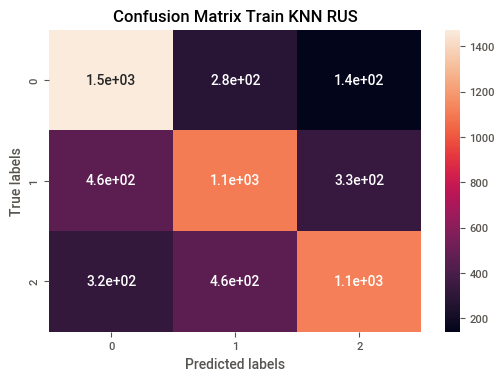

              precision    recall  f1-score   support

           0       0.65      0.78      0.71      1898
           1       0.60      0.58      0.59      1898
           2       0.70      0.59      0.64      1898

    accuracy                           0.65      5694
   macro avg       0.65      0.65      0.65      5694
weighted avg       0.65      0.65      0.65      5694

--------------Test data ---------------

Confusion matrix 

[[7138 2553 1297]
 [ 674  846  688]
 [ 101  181  193]]


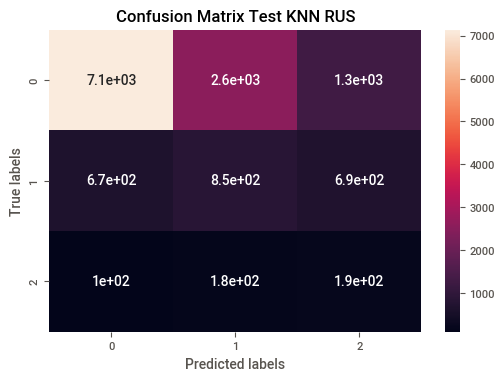

              precision    recall  f1-score   support

           0       0.90      0.65      0.76     10988
           1       0.24      0.38      0.29      2208
           2       0.09      0.41      0.15       475

    accuracy                           0.60     13671
   macro avg       0.41      0.48      0.40     13671
weighted avg       0.77      0.60      0.66     13671



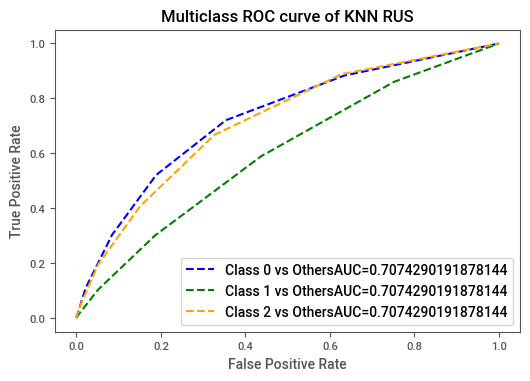

----- Evaluation on SMOTE data -------KNN TomekLinks-----
--------------- Train Data ------------

Confusion matrix 

[[39596   554    54]
 [ 3239  2010    72]
 [ 1269   380   249]]


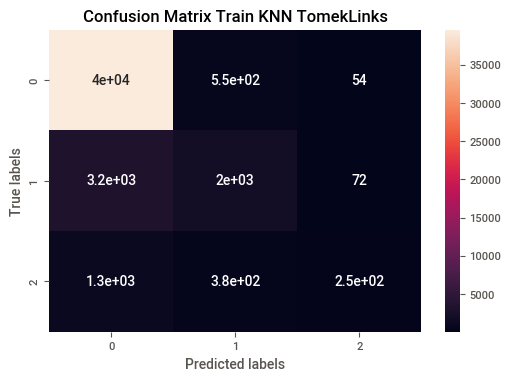

              precision    recall  f1-score   support

           0       0.90      0.98      0.94     40204
           1       0.68      0.38      0.49      5321
           2       0.66      0.13      0.22      1898

    accuracy                           0.88     47423
   macro avg       0.75      0.50      0.55     47423
weighted avg       0.86      0.88      0.86     47423

---------------Test data ---------------

Confusion matrix 

[[10506   431    51]
 [ 1755   383    70]
 [  346   108    21]]


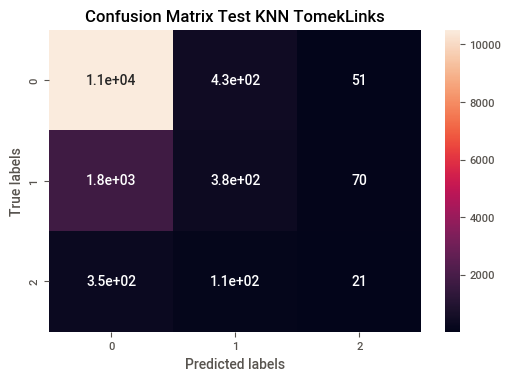

              precision    recall  f1-score   support

           0       0.83      0.96      0.89     10988
           1       0.42      0.17      0.24      2208
           2       0.15      0.04      0.07       475

    accuracy                           0.80     13671
   macro avg       0.47      0.39      0.40     13671
weighted avg       0.74      0.80      0.76     13671



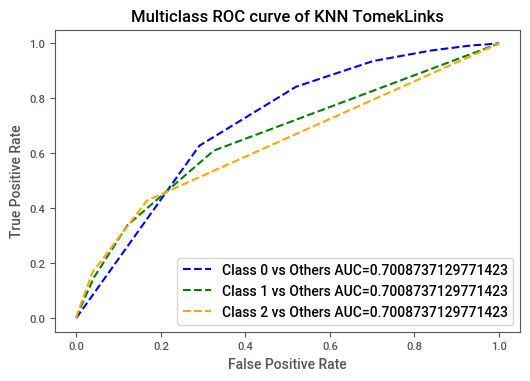

----- Evaluation on SMOTE data -------KNN SMOTETomek-----
--------------- Train Data ------------

Confusion matrix 

[[31281  7507  3464]
 [  759 40461  1122]
 [  306   775 42110]]


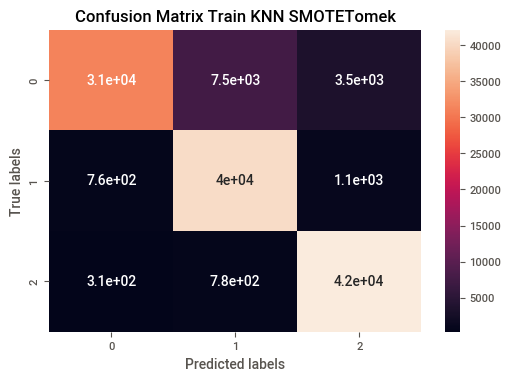

              precision    recall  f1-score   support

           0       0.97      0.74      0.84     42252
           1       0.83      0.96      0.89     42342
           2       0.90      0.97      0.94     43191

    accuracy                           0.89    127785
   macro avg       0.90      0.89      0.89    127785
weighted avg       0.90      0.89      0.89    127785

---------------Test data ---------------

Confusion matrix 

[[7036 2797 1155]
 [ 773  920  515]
 [ 135  211  129]]


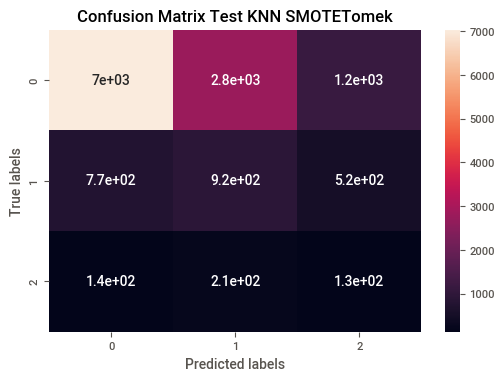

              precision    recall  f1-score   support

           0       0.89      0.64      0.74     10988
           1       0.23      0.42      0.30      2208
           2       0.07      0.27      0.11       475

    accuracy                           0.59     13671
   macro avg       0.40      0.44      0.39     13671
weighted avg       0.75      0.59      0.65     13671



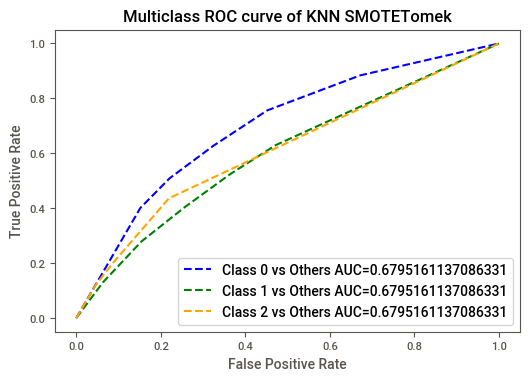

[{'Model_Name': 'KNN RUS',
  'Test_AUC': 0.7074290191878144,
  'Test_Accuracy': 0.5981274230122157,
  'Test_F1score': 0.6593411311053835,
  'Test_Precision': 0.7662719871310544,
  'Test_Recall': 0.5981274230122157,
  'Train_AUC': 0.8430384728272194,
  'Train_Accuracy': 0.6484018264840182,
  'Train_F1score': 0.6459954962904091,
  'Train_Precision': 0.6505056877177817,
  'Train_Recall': 0.6484018264840182},
 {'Model_Name': 'KNN TomekLinks',
  'Test_AUC': 0.7008737129771423,
  'Test_Accuracy': 0.7980396459659133,
  'Test_F1score': 0.7576484617747535,
  'Test_Precision': 0.7420279776538787,
  'Test_Recall': 0.7980396459659133,
  'Train_AUC': 0.9304581188136837,
  'Train_Accuracy': 0.8825886173375788,
  'Train_F1score': 0.8596723712555399,
  'Train_Precision': 0.8643018438569063,
  'Train_Recall': 0.8825886173375788},
 {'Model_Name': 'KNN SMOTETomek',
  'Test_AUC': 0.6795161137086331,
  'Test_Accuracy': 0.5913978494623656,
  'Test_F1score': 0.6497910933066283,
  'Test_Precision': 0.75219660

In [ ]:
#model eval of knn
knn_eval_list = model_evaluation('KNN RUS','KNN TomekLinks','KNN SMOTETomek',knn_rus,knn_tomek,knn_smotom,x_train_rus, y_train_rus,
                                x_train_tomek, y_train_tomek, x_train_smotom,y_train_smotom, X_test, y_test)
knn_eval_list

In [ ]:
#adding list
add_list_to_final_df(knn_eval_list)
#Taking a look of our final comparison dataframe
comparison_df

,Model_Name,Train_Accuracy,Train_Recall,Train_Precision,Train_F1score,Train_AUC,Test_Accuracy,Test_Recall,Test_Precision,Test_F1score,Test_AUC
0,LogisticReg RUS,0.541272,0.541272,0.531091,0.517285,0.721179,0.621096,0.621096,0.773397,0.678697,0.763134
1,LogisticReg TomekLinks,0.673492,0.673492,0.825820,0.730936,0.810364,0.628630,0.628630,0.773032,0.683728,0.768714
2,LogisticReg SMOTETomek,0.537191,0.537191,0.520244,0.510151,0.722263,0.625485,0.625485,0.772229,0.681408,0.765839
3,Decision Tree RUS,0.998595,0.998595,0.998597,0.998595,0.999998,0.492063,0.492063,0.741624,0.573173,0.603546
4,Decision Tree TomekLinks,0.996436,0.996436,0.996435,0.996418,0.999968,0.731402,0.731402,0.730798,0.730564,0.600575
5,Decision Tree SMOTETomek,0.998677,0.998677,0.998680,0.998678,0.999998,0.697901,0.697901,0.731444,0.713411,0.607395
6,Random Forest RUS,0.563927,0.563927,0.558545,0.541117,0.751515,0.628849,0.628849,0.774292,0.684142,0.763393
7,Random Forest TomekLinks,0.854058,0.854058,0.798331,0.794933,0.818323,0.809451,0.809451,0.757062,0.732482,0.769994
8,Random Forest SMOTETomek,0.564542,0.564542,0.547718,0.539679,0.759181,0.669081,0.669081,0.772525,0.709891,0.764381
9,RandomF Tuned RUS,0.739726,0.739726,0.742157,0.738555,0.909722,0.616707,0.616707,0.780552,0.677220,0.758513


KNN  Hyperparameter Tuning:

In [ ]:
#knn tuning rus
knn_rus = KNeighborsClassifier()
params = [{'n_neighbors': range(5,10),'metric': ['canberra', 'euclidean', 'minkowski']}]
knn_rus_search = GridSearchCV(knn_rus, cv = 10, param_grid = params, scoring = "f1_weighted")
knn_rus_search.fit(x_train_rus,y_train_rus)
knn_rus_tuned = knn_rus_search.best_estimator_

#knn tuning TomekLinks
knn_tomek = KNeighborsClassifier()
knn_tomek_search = GridSearchCV(knn_tomek, cv = 10, param_grid = params, scoring = "f1_weighted")
knn_tomek_search.fit(x_train_tomek,y_train_tomek)
knn_tomek_tuned = knn_tomek_search.best_estimator_

#knn tuning SMOTETomek
knn_smotom = KNeighborsClassifier()
knn_smotom_search = GridSearchCV(knn_smotom, cv = 10, param_grid = params, scoring = "f1_weighted")
knn_smotom_search.fit(x_train_smotom,y_train_smotom)
knn_smotom_tuned = knn_smotom_search.best_estimator_

----- Evaluation on Random Undersampled data -----KNN Tuned RUS------
--------------- Train Data ------------

Confusion matrix 

[[1371  296  231]
 [ 459  959  480]
 [ 286  473 1139]]


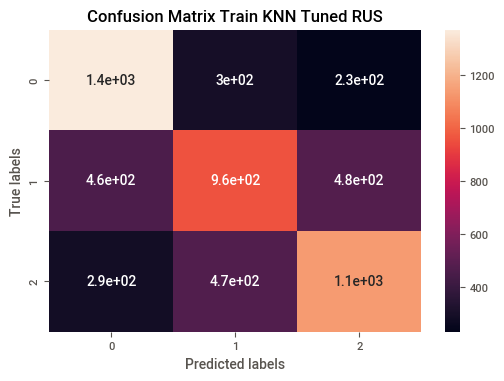

              precision    recall  f1-score   support

           0       0.65      0.72      0.68      1898
           1       0.55      0.51      0.53      1898
           2       0.62      0.60      0.61      1898

    accuracy                           0.61      5694
   macro avg       0.61      0.61      0.61      5694
weighted avg       0.61      0.61      0.61      5694

--------------Test data ---------------

Confusion matrix 

[[7131 2361 1496]
 [ 641  806  761]
 [  80  160  235]]


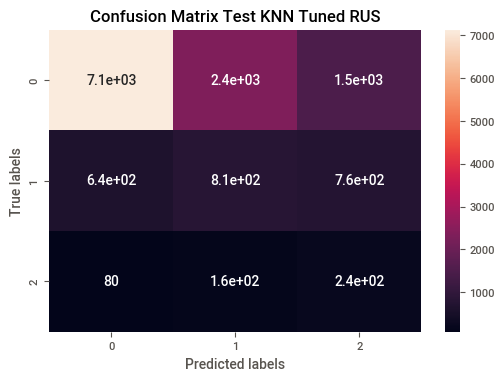

              precision    recall  f1-score   support

           0       0.91      0.65      0.76     10988
           1       0.24      0.37      0.29      2208
           2       0.09      0.49      0.16       475

    accuracy                           0.60     13671
   macro avg       0.41      0.50      0.40     13671
weighted avg       0.77      0.60      0.66     13671



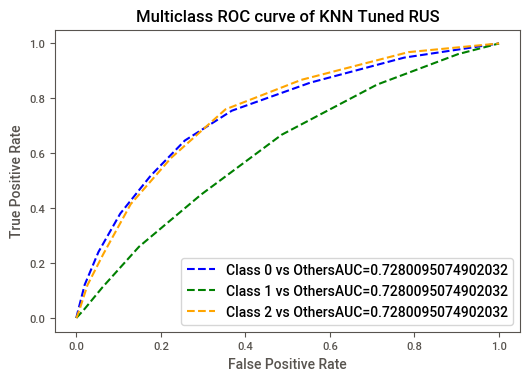

----- Evaluation on SMOTE data -------KNN Tuned TomekLinks-----
--------------- Train Data ------------

Confusion matrix 

[[39594   539    71]
 [ 3555  1655   111]
 [ 1281   403   214]]


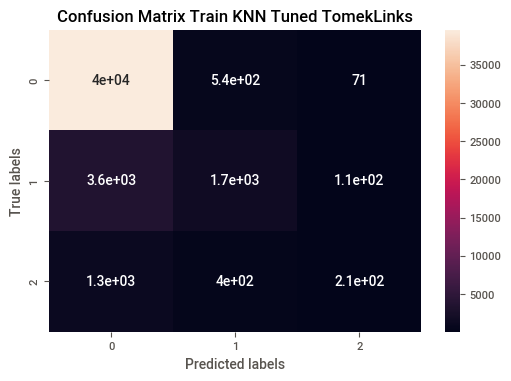

              precision    recall  f1-score   support

           0       0.89      0.98      0.94     40204
           1       0.64      0.31      0.42      5321
           2       0.54      0.11      0.19      1898

    accuracy                           0.87     47423
   macro avg       0.69      0.47      0.51     47423
weighted avg       0.85      0.87      0.85     47423

---------------Test data ---------------

Confusion matrix 

[[10566   367    55]
 [ 1765   362    81]
 [  359    92    24]]


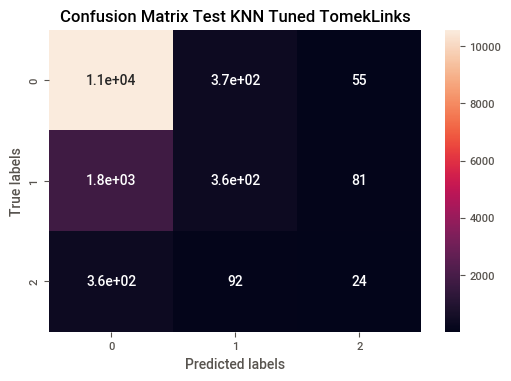

              precision    recall  f1-score   support

           0       0.83      0.96      0.89     10988
           1       0.44      0.16      0.24      2208
           2       0.15      0.05      0.08       475

    accuracy                           0.80     13671
   macro avg       0.47      0.39      0.40     13671
weighted avg       0.75      0.80      0.76     13671



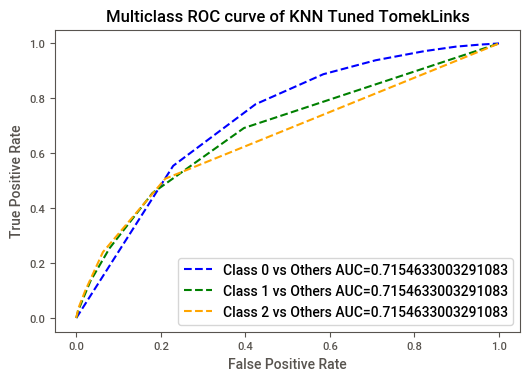

----- Evaluation on SMOTE data -------KNN Tuned SMOTETomek-----
--------------- Train Data ------------

Confusion matrix 

[[31281  7507  3464]
 [  759 40461  1122]
 [  306   775 42110]]


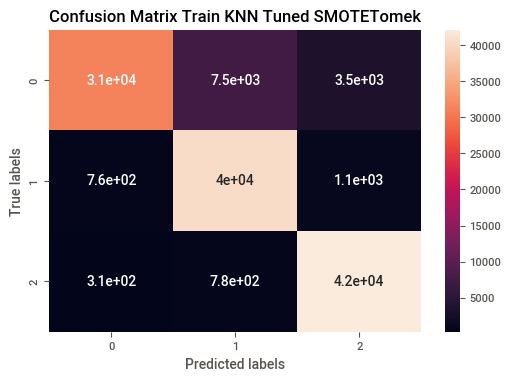

              precision    recall  f1-score   support

           0       0.97      0.74      0.84     42252
           1       0.83      0.96      0.89     42342
           2       0.90      0.97      0.94     43191

    accuracy                           0.89    127785
   macro avg       0.90      0.89      0.89    127785
weighted avg       0.90      0.89      0.89    127785

---------------Test data ---------------

Confusion matrix 

[[7036 2797 1155]
 [ 773  920  515]
 [ 135  211  129]]


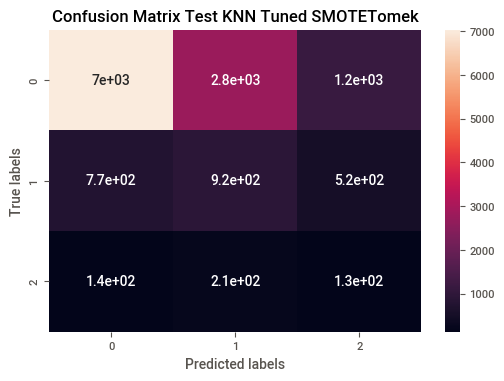

              precision    recall  f1-score   support

           0       0.89      0.64      0.74     10988
           1       0.23      0.42      0.30      2208
           2       0.07      0.27      0.11       475

    accuracy                           0.59     13671
   macro avg       0.40      0.44      0.39     13671
weighted avg       0.75      0.59      0.65     13671



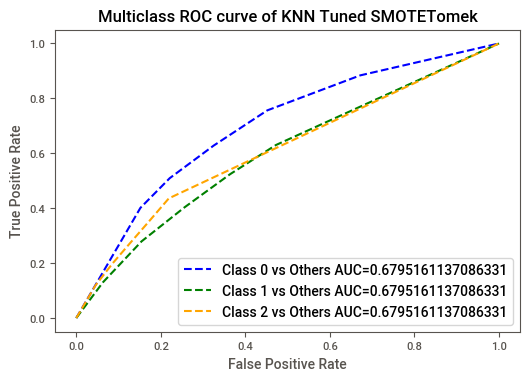

[{'Model_Name': 'KNN Tuned RUS',
  'Test_AUC': 0.7280095074902032,
  'Test_Accuracy': 0.597761685319289,
  'Test_F1score': 0.6609818532919168,
  'Test_Precision': 0.7723461943544411,
  'Test_Recall': 0.597761685319289,
  'Train_AUC': 0.802417797485605,
  'Train_Accuracy': 0.609237794169301,
  'Train_F1score': 0.6066191562719456,
  'Train_Precision': 0.6061910441474871,
  'Train_Recall': 0.609237794169301},
 {'Model_Name': 'KNN Tuned TomekLinks',
  'Test_AUC': 0.7154633003291083,
  'Test_Accuracy': 0.8011118425864969,
  'Test_F1score': 0.7585525867184856,
  'Test_Precision': 0.7456431647481581,
  'Test_Recall': 0.8011118425864969,
  'Train_AUC': 0.9124655871795174,
  'Train_Accuracy': 0.8743225860869198,
  'Train_F1score': 0.8475939293442686,
  'Train_Precision': 0.8486304365413644,
  'Train_Recall': 0.8743225860869198},
 {'Model_Name': 'KNN Tuned SMOTETomek',
  'Test_AUC': 0.6795161137086331,
  'Test_Accuracy': 0.5913978494623656,
  'Test_F1score': 0.6497910933066283,
  'Test_Precision

In [ ]:
#knn tuned model evaluation
knn_tuned_eval_list = model_evaluation('KNN Tuned RUS', 'KNN Tuned TomekLinks','KNN Tuned SMOTETomek', knn_rus_tuned, knn_tomek_tuned,knn_smotom_tuned, x_train_rus, y_train_rus,
                                       x_train_tomek, y_train_tomek,x_train_smotom,y_train_smotom, X_test, y_test)
knn_tuned_eval_list

In [ ]:
#adding list
add_list_to_final_df(knn_tuned_eval_list)
#Taking a look of our final comparison dataframe
comparison_df

,Model_Name,Train_Accuracy,Train_Recall,Train_Precision,Train_F1score,Train_AUC,Test_Accuracy,Test_Recall,Test_Precision,Test_F1score,Test_AUC
0,LogisticReg RUS,0.541272,0.541272,0.531091,0.517285,0.721179,0.621096,0.621096,0.773397,0.678697,0.763134
1,LogisticReg TomekLinks,0.673492,0.673492,0.825820,0.730936,0.810364,0.628630,0.628630,0.773032,0.683728,0.768714
2,LogisticReg SMOTETomek,0.537191,0.537191,0.520244,0.510151,0.722263,0.625485,0.625485,0.772229,0.681408,0.765839
3,Decision Tree RUS,0.998595,0.998595,0.998597,0.998595,0.999998,0.492063,0.492063,0.741624,0.573173,0.603546
4,Decision Tree TomekLinks,0.996436,0.996436,0.996435,0.996418,0.999968,0.731402,0.731402,0.730798,0.730564,0.600575
5,Decision Tree SMOTETomek,0.998677,0.998677,0.998680,0.998678,0.999998,0.697901,0.697901,0.731444,0.713411,0.607395
6,Random Forest RUS,0.563927,0.563927,0.558545,0.541117,0.751515,0.628849,0.628849,0.774292,0.684142,0.763393
7,Random Forest TomekLinks,0.854058,0.854058,0.798331,0.794933,0.818323,0.809451,0.809451,0.757062,0.732482,0.769994
8,Random Forest SMOTETomek,0.564542,0.564542,0.547718,0.539679,0.759181,0.669081,0.669081,0.772525,0.709891,0.764381
9,RandomF Tuned RUS,0.739726,0.739726,0.742157,0.738555,0.909722,0.616707,0.616707,0.780552,0.677220,0.758513


XG Boost Model:

In [ ]:
#fitting rus
xgb_rus = XGBClassifier(n_estimators=100,max_depth=12,min_samples_leaf=20,min_samples_split=30)
xgb_rus.fit(x_train_rus,y_train_rus)

XGBClassifier(max_depth=12, min_samples_leaf=20, min_samples_split=30,
              objective='multi:softprob')

In [ ]:
#fitting TomekLinks
xgb_tomek = XGBClassifier(n_estimators=100,max_depth=12,min_samples_leaf=20,min_samples_split=30)
xgb_tomek.fit(x_train_tomek,y_train_tomek)

XGBClassifier(max_depth=12, min_samples_leaf=20, min_samples_split=30,
              objective='multi:softprob')

In [ ]:
#fitting SMOTETomek
xgb_smotom = XGBClassifier(n_estimators=100,max_depth=12,min_samples_leaf=20,min_samples_split=30)
xgb_smotom.fit(x_train_smotom,y_train_smotom)

XGBClassifier(max_depth=12, min_samples_leaf=20, min_samples_split=30,
              objective='multi:softprob')

----- Evaluation on Random Undersampled data -----XGB RUS------
--------------- Train Data ------------

Confusion matrix 

[[1859   16   23]
 [  14 1814   70]
 [   6   15 1877]]


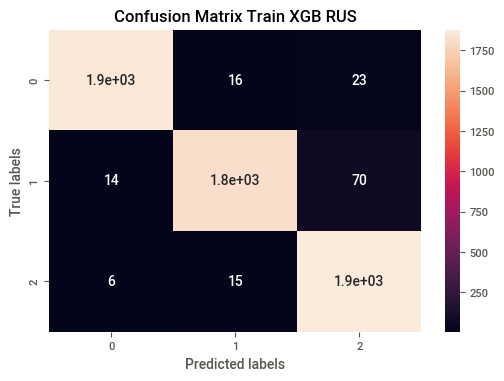

              precision    recall  f1-score   support

           0       0.99      0.98      0.98      1898
           1       0.98      0.96      0.97      1898
           2       0.95      0.99      0.97      1898

    accuracy                           0.97      5694
   macro avg       0.98      0.97      0.97      5694
weighted avg       0.98      0.97      0.97      5694

--------------Test data ---------------

Confusion matrix 

[[6811 2358 1819]
 [ 610  743  855]
 [  93  139  243]]


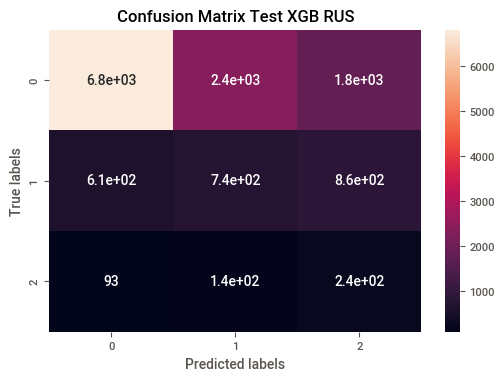

              precision    recall  f1-score   support

           0       0.91      0.62      0.74     10988
           1       0.23      0.34      0.27      2208
           2       0.08      0.51      0.14       475

    accuracy                           0.57     13671
   macro avg       0.41      0.49      0.38     13671
weighted avg       0.77      0.57      0.64     13671



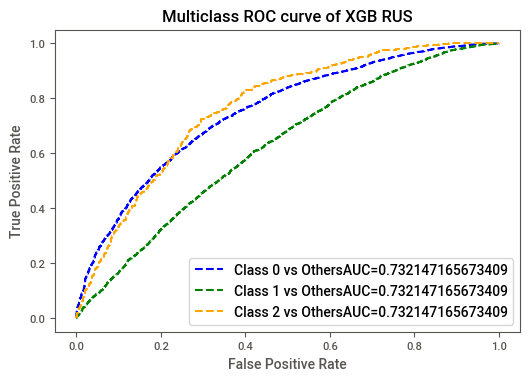

----- Evaluation on SMOTE data -------XGB TomekLinks-----
--------------- Train Data ------------

Confusion matrix 

[[40062   133     9]
 [ 2184  3123    14]
 [  836   172   890]]


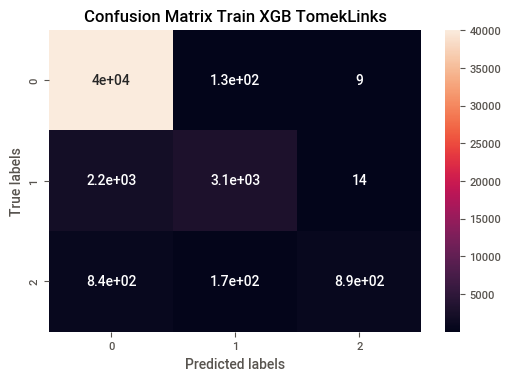

              precision    recall  f1-score   support

           0       0.93      1.00      0.96     40204
           1       0.91      0.59      0.71      5321
           2       0.97      0.47      0.63      1898

    accuracy                           0.93     47423
   macro avg       0.94      0.68      0.77     47423
weighted avg       0.93      0.93      0.92     47423

---------------Test data ---------------

Confusion matrix 

[[10572   371    45]
 [ 1772   369    67]
 [  346   106    23]]


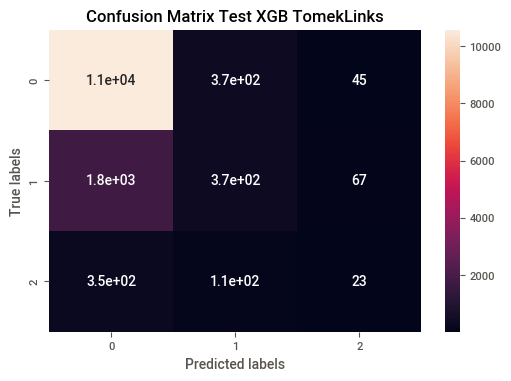

              precision    recall  f1-score   support

           0       0.83      0.96      0.89     10988
           1       0.44      0.17      0.24      2208
           2       0.17      0.05      0.08       475

    accuracy                           0.80     13671
   macro avg       0.48      0.39      0.40     13671
weighted avg       0.75      0.80      0.76     13671



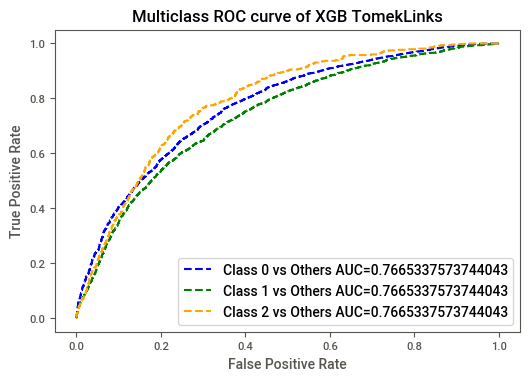

----- Evaluation on SMOTE data -------XGB SMOTETomek-----
--------------- Train Data ------------

Confusion matrix 

[[40906  1074   272]
 [ 3900 35327  3115]
 [  658   695 41838]]


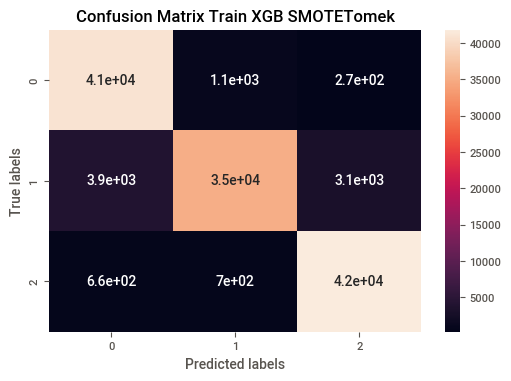

              precision    recall  f1-score   support

           0       0.90      0.97      0.93     42252
           1       0.95      0.83      0.89     42342
           2       0.93      0.97      0.95     43191

    accuracy                           0.92    127785
   macro avg       0.93      0.92      0.92    127785
weighted avg       0.93      0.92      0.92    127785

---------------Test data ---------------

Confusion matrix 

[[10151   702   135]
 [ 1509   539   160]
 [  278   148    49]]


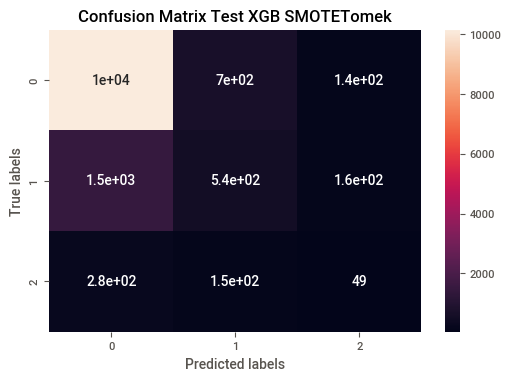

              precision    recall  f1-score   support

           0       0.85      0.92      0.89     10988
           1       0.39      0.24      0.30      2208
           2       0.14      0.10      0.12       475

    accuracy                           0.79     13671
   macro avg       0.46      0.42      0.43     13671
weighted avg       0.75      0.79      0.76     13671



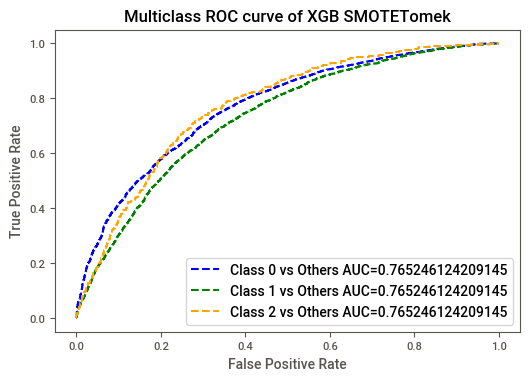

[{'Model_Name': 'XGB RUS',
  'Test_AUC': 0.732147165673409,
  'Test_Accuracy': 0.5703313583497915,
  'Test_F1score': 0.6407848582060025,
  'Test_Precision': 0.768479819588336,
  'Test_Recall': 0.5703313583497915,
  'Train_AUC': 0.9986252698660858,
  'Train_Accuracy': 0.9747102212855637,
  'Train_F1score': 0.9747275076857357,
  'Train_Precision': 0.9751152501993183,
  'Train_Recall': 0.9747102212855637},
 {'Model_Name': 'XGB TomekLinks',
  'Test_AUC': 0.7665337573744043,
  'Test_Accuracy': 0.8019896130495209,
  'Test_F1score': 0.7593780147627748,
  'Test_Precision': 0.7459628985769892,
  'Test_Recall': 0.8019896130495209,
  'Train_AUC': 0.9803945142851486,
  'Train_Accuracy': 0.9294013453387596,
  'Train_F1score': 0.9210343613872968,
  'Train_Precision': 0.9295806799108705,
  'Train_Recall': 0.9294013453387596},
 {'Model_Name': 'XGB SMOTETomek',
  'Test_AUC': 0.765246124209145,
  'Test_Accuracy': 0.7855314168678224,
  'Test_F1score': 0.7643134078879942,
  'Test_Precision': 0.75105533909

In [ ]:
#model evaluation of XGB
xgb_eval_list = model_evaluation('XGB RUS', 'XGB TomekLinks','XGB SMOTETomek',xgb_rus, xgb_tomek,xgb_smotom,x_train_rus, y_train_rus,
                                 x_train_tomek, y_train_tomek,x_train_smotom,y_train_smotom, X_test, y_test)
xgb_eval_list

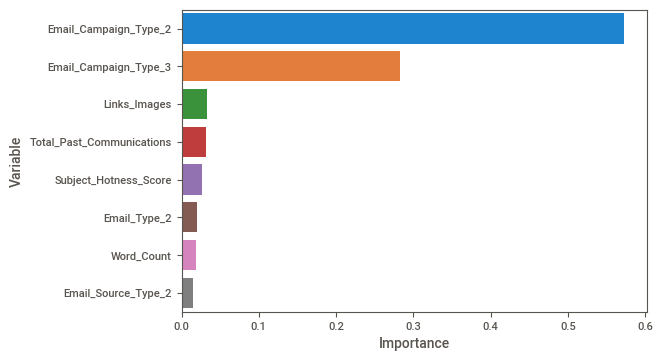

In [ ]:
#visualising feature importance of XGB
feature_imp_xgb = pd.DataFrame({"Variable": x_train_smotom.columns,"Importance": xgb_smotom.feature_importances_})
feature_imp_xgb.sort_values(by="Importance", ascending=False, inplace = True)
sns.barplot(x=feature_imp_xgb['Importance'], y= feature_imp_xgb['Variable'])

In [ ]:
#adding list
add_list_to_final_df(xgb_eval_list)
#Taking a look of our final comparison dataframe
np.round(comparison_df, decimals = 3)

,Model_Name,Train_Accuracy,Train_Recall,Train_Precision,Train_F1score,Train_AUC,Test_Accuracy,Test_Recall,Test_Precision,Test_F1score,Test_AUC
0,LogisticReg RUS,0.541,0.541,0.531,0.517,0.721,0.621,0.621,0.773,0.679,0.763
1,LogisticReg TomekLinks,0.673,0.673,0.826,0.731,0.810,0.629,0.629,0.773,0.684,0.769
2,LogisticReg SMOTETomek,0.537,0.537,0.520,0.510,0.722,0.625,0.625,0.772,0.681,0.766
3,Decision Tree RUS,0.999,0.999,0.999,0.999,1.000,0.492,0.492,0.742,0.573,0.604
4,Decision Tree TomekLinks,0.996,0.996,0.996,0.996,1.000,0.731,0.731,0.731,0.731,0.601
5,Decision Tree SMOTETomek,0.999,0.999,0.999,0.999,1.000,0.698,0.698,0.731,0.713,0.607
6,Random Forest RUS,0.564,0.564,0.559,0.541,0.752,0.629,0.629,0.774,0.684,0.763
7,Random Forest TomekLinks,0.854,0.854,0.798,0.795,0.818,0.809,0.809,0.757,0.732,0.770
8,Random Forest SMOTETomek,0.565,0.565,0.548,0.540,0.759,0.669,0.669,0.773,0.710,0.764
9,RandomF Tuned RUS,0.740,0.740,0.742,0.739,0.910,0.617,0.617,0.781,0.677,0.759


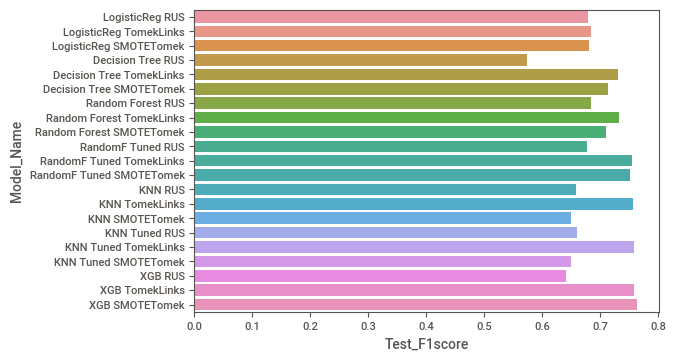

In [ ]:
#visualising our comparison df for f1 score
sns.barplot(y=comparison_df['Model_Name'], x = comparison_df['Test_F1score'])

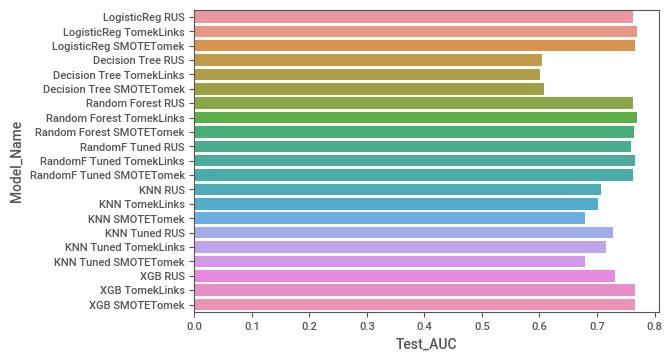

In [ ]:
#visualising for auc
sns.barplot(y=comparison_df['Model_Name'], x = comparison_df['Test_AUC'])

In [ ]:
#sorting values
comparison_df.sort_values(by=["Test_F1score",'Test_AUC'], ascending=(False,False), inplace = True, ignore_index = True)
np.round(comparison_df, decimals = 3)

,Model_Name,Train_Accuracy,Train_Recall,Train_Precision,Train_F1score,Train_AUC,Test_Accuracy,Test_Recall,Test_Precision,Test_F1score,Test_AUC
0,XGB SMOTETomek,0.924,0.924,0.926,0.923,0.987,0.786,0.786,0.751,0.764,0.765
1,XGB TomekLinks,0.929,0.929,0.930,0.921,0.980,0.802,0.802,0.746,0.759,0.767
2,KNN Tuned TomekLinks,0.874,0.874,0.849,0.848,0.912,0.801,0.801,0.746,0.759,0.715
3,KNN TomekLinks,0.883,0.883,0.864,0.860,0.930,0.798,0.798,0.742,0.758,0.701
4,RandomF Tuned TomekLinks,0.882,0.882,0.871,0.853,0.945,0.807,0.807,0.747,0.755,0.767
5,RandomF Tuned SMOTETomek,0.905,0.905,0.905,0.905,0.983,0.743,0.743,0.761,0.751,0.762
6,Random Forest TomekLinks,0.854,0.854,0.798,0.795,0.818,0.809,0.809,0.757,0.732,0.770
7,Decision Tree TomekLinks,0.996,0.996,0.996,0.996,1.000,0.731,0.731,0.731,0.731,0.601
8,Decision Tree SMOTETomek,0.999,0.999,0.999,0.999,1.000,0.698,0.698,0.731,0.713,0.607
9,Random Forest SMOTETomek,0.565,0.565,0.548,0.540,0.759,0.669,0.669,0.773,0.710,0.764




---


# Conclusion:

---
* ### In EDA, we observed that Email_Campaign_Type was the most important feature. If your Email_Campaign_Type was 1, there is a 90% likelihood of your Email to be read/acknowledged.
* ### It was observed that both Time_Email_Sent and Customer_Location was insignificant in determining the Email status. The ratio of the Email Status was the same irrespective of the demographic location or the time frame the emails were sent on.
* ### As the word_count increases beyond the 600 mark we see that there is a high possibility of that email being ignored. The ideal mark is 400-600. No one is interested in reading long emails! 
* ### For modelling, it was observed that for imbalance handling Oversampling i.e., SMOTE worked way better than under sampling as the latter resulted in a lot of loss of information.
* ### Based on the metrics, XGBoost Classifier worked the best, giving a train score of 89% and test score of 81% for F1 score.
--- 




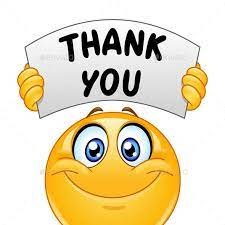